# Redes neuronales y algoritmos bioinspirados


Departamento de Informática y Ciencias de la Decisión. Facultad de Minas.
Universidad Nacional de Colombia.



Trabajo 1 - Optimización heurística


Autores: David Cardona y Sebastian Gaviria

## Introducción

**Contexto general y tema de estudio**: La optimización es un proceso fundamental en el campo de la inteligencia artificial (IA), ya que permite encontrar soluciones óptimas a problemas complejos. Los métodos heurísticos son una herramienta importante en este proceso, ya que permiten encontrar soluciones aproximadas a problemas de optimización en un tiempo razonable. Estos métodos son especialmente útiles cuando se trata de problemas de alta complejidad o con un espacio de búsqueda muy grande.

---

**Problema o pregunta de estudio y motivación**: En este trabajo se estudia la optimización de dos funciones utilizando diferentes métodos: gradiente con condición inicial aleatoria, algoritmos evolutivos, optimización de partículas y evolución diferencial. La motivación detrás de este estudio radica en la importancia de encontrar soluciones óptimas a problemas complejos en diversos campos de aplicación.

---

**Objetivo del informe**: El objetivo del informe es comparar estos métodos entre sí para determinar cuál es el más efectivo en la resolución del problema planteado, además practicar las distintas maneras de optimización.

# Librerias

In [7]:
#@title ‎ 
import warnings
warnings.filterwarnings('ignore')

In [ ]:
pip install pyswarms pygad basemap

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation
from scipy.optimize import differential_evolution
from IPython.display import HTML,Image, display
import imageio



# Funcion de Rosenbrock








Definida como:  $f(x_1,x_2)=100 \cdot (x_2-x_1^2)^2+(1-x_1)^2), \ x_i \in [-2.048,2.048], \ i=\{1,2\} \\ 
Alcanza \ su \ valor \ mínimo \ en \ x_1=1 \ y \ x_2=1 \ el \ cual \ es \ 0$



## Funcion de interes

Se define como código la función de interés que se usará en la mayor parte del código, como único argumento tiene un valor que debe ser una lista, esto a razón de que para la mayoría de optimizaciones es preferible utilizar la función de manera vectorial. La función utiliza operaciones de NumPy para calcular la suma de los términos cuadráticos y lineales de la función.

In [ ]:

#Definir la funcion de interes
def rosenbrock(x):
    return np.sum(100.0*(x[1:]-x[:-1]**2.0)**2.0 + (1-x[:-1])**2.0)

## Graficas de la funcion

En esta sección se generan dos gráficos de la función de Rosenbrock. El primer gráfico es una representación en 3D de la función y el segundo es una representación en 2D utilizando contornos.

Para generar los gráficos, el código primero define un rango de valores para las variables x,y utilizando la función np.linspace. Luego utiliza la función np.meshgrid para crear una cuadrícula de valores para x , y. A continuación, se calcula el valor de la función de Rosenbrock para cada combinación de valores de x, y utilizando la implementación previamente definida de la función. Los valores calculados se almacenan en un arreglo Z.

El primer gráfico se genera utilizando la función plot_surface del módulo matplotlib para crear una superficie 3D a partir de los valores almacenados en los arreglos X, Y y Z. También se agrega una barra de colores y etiquetas a los ejes.

El segundo gráfico se genera utilizando la función contour del módulo matplotlib para crear un gráfico de contorno a partir de los valores almacenados en los arreglos X, Y y Z. También se agrega un título al gráfico.

Finalmente, ambos gráficos se muestran utilizando la función show. De ambos gráficos podemos observar que la gráfica en 3D muestra un valle plano largo y estrecho con forma parabólica. Este valle representa el área donde se encuentra el mínimo global de la función. La gráfica en 2D muestra contornos que representan diferentes niveles de altura en la función. Los contornos más cercanos al centro del valle representan valores más bajos de la función.

La forma del valle y su estrechez hacen que sea difícil para los algoritmos de optimización encontrar el mínimo global. Esto convierte a la función de Rosenbrock en un buen problema de prueba para evaluar el rendimiento de los algoritmos.


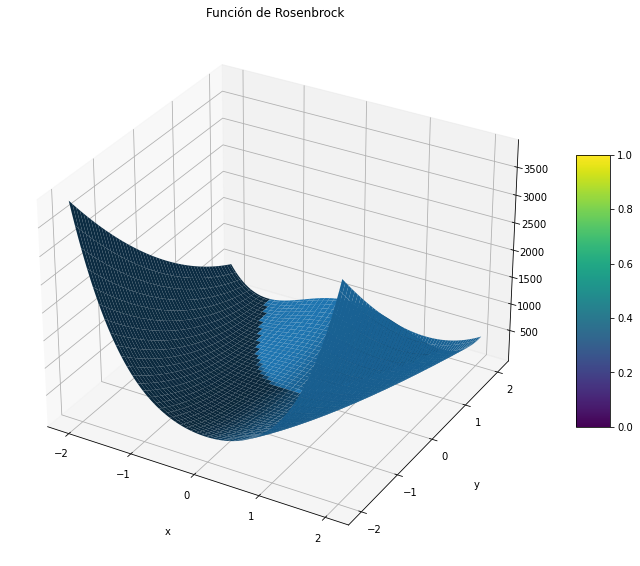

In [ ]:
#Graficar la funcion en 3d

ncols = 100
nrows = 100
X = np.linspace(-2.048, 2.048, ncols)     
Y = np.linspace(-2.048, 2.048, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [rosenbrock(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

fig = plt.figure(figsize = (12,10))
ax = plt.axes(projection='3d')

superficie = ax.plot_surface(X,Y,Z)
fig.colorbar(superficie, shrink=0.5, aspect=8)
plt.title("Función de Rosenbrock")
ax.set_xlabel('x', labelpad=20)
ax.set_ylabel('y', labelpad=20)
ax.set_zlabel('z', labelpad=20)
plt.show()

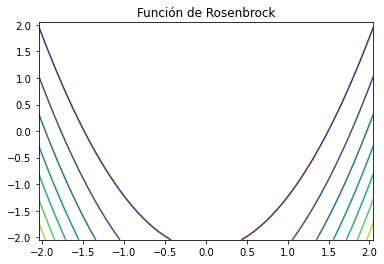

In [ ]:
#Graficar la funcion en 2d
ncols = 100
nrows = 100
X = np.linspace(-2.048, 2.048, ncols)     
Y = np.linspace(-2.048, 2.048, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [rosenbrock(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

fig, ax = plt.subplots()
ax.contour(X,Y,Z)
plt.title("Función de Rosenbrock")
plt.show()

## Metodo del gradiante


### Calculo de la optimización usando gradiente descendente

Se define e implementa el algoritmo de descenso por gradiente para minimizar la función de Rosenbrock en dos y tres dimensiones.

Primero se define una función rosenbrock_gradient que calcula el gradiente de la función de Rosenbrock. Esta función toma como entrada un vector x y devuelve el gradiente de la función en ese punto, matemáticamente se define como:

$\nabla f(x) = \begin{bmatrix} -400x_0(x_1-x_0^2) - 2(1-x_0) 
200(x_1-x_0^2)-400x_1(x_2-x_1^2)-2(1-x_1) 
\vdots 
200(x_{n-2}-x_{n-3}^2)-400x_{n-2}(x_{n-1}-x_{n-2}^2)-2(1-x_{n-2}) 
200(x_{n-1}-x_{n-2}^2) \end{bmatrix}$


Luego se define una función gradient_descent que implementa el algoritmo de descenso por gradiente. Esta función toma como entrada la función objetivo func, su gradiente gradient, un punto inicial x0, un tamaño de paso alpha, un número máximo de iteraciones max_iter, los límites del dominio y una tolerancia para detener el algoritmo. La función devuelve el mínimo encontrado, el valor mínimo y el número de evaluaciones de la función objetivo. El algoritmo de descenso por gradiente se podría definir matemáticamente como:

Dado un punto inicial $x_0$, el algoritmo actualiza el valor de $x$ en cada iteración utilizando la siguiente fórmula:

$x_{k+1} = x_k - \alpha \nabla f(x_k)$

Donde $k$ es el número de iteración, $\alpha$ es el tamaño del paso y $\nabla f(x_k)$ es el gradiente de la función en el punto $x_k$ El algoritmo se detiene cuando se alcanza un número máximo de iteraciones o cuando la magnitud del gradiente es menor que una tolerancia predefinida.



Luego se utilizan estas funciones para minimizar la función de Rosenbrock en dos y tres dimensiones. Para cada caso se genera un punto inicial aleatorio utilizando la función np.random.uniform. Luego se llama a la función gradient_descent con los parámetros adecuados para encontrar el mínimo, entre ellos los más importantes el alpha y la tolerancia los cuales se eligieron teniendo en cuenta que la tasa de aprendizaje alpha debe ser lo suficientemente pequeña para que el algoritmo converja, pero lo suficientemente grande como para que no tome demasiadas iteraciones y que una tolerancia más estricta resulta en una mayor precisión pero también en un mayor costo computacional. Finalmente, se imprimen los resultados obtenidos.



In [ ]:

#Definir la derivada de la funcion de interes
def rosenbrock_gradient(x):
    grad = np.zeros_like(x)
    grad[0] = -400.0*x[0]*(x[1]-x[0]**2) - 2.0*(1-x[0])
    grad[-1] = 200.0*(x[-1]-x[-2]**2)
    grad[1:-1] = -400.0*x[1:-1]*(x[2:]-x[1:-1]**2) + \
        200.0*(x[1:-1]-x[:-2]**2) - 2.0*(1-x[1:-1])
    return grad

#Definir el descenso por grandiente
def gradient_descent(func, gradient, x0, alpha, max_iter,bounds,tol=1e-6):
    x = x0.copy()
    i = 0
    func_evals = 0  # Inicializar el contador de evaluaciones de la función objetivo
    while i < max_iter:
        grad = gradient(x)
        func_evals += 1  # Incrementar el contador en cada iteración del bucle
        if np.max(np.abs(grad)) < tol:
            break
        x -= alpha * grad
        x = np.clip(x, bounds[0],bounds[1])
        i += 1
    return x, func(x), func_evals

# Minimización en dos dimensiones
x0 = np.random.uniform(-2.048, 2.048, size=2)
x_min, f_min, func_evals = gradient_descent(rosenbrock, rosenbrock_gradient, x0,0.001,1000000,[-2.048,2.048])

print("Rosenbrock en dos dimensiones")
print("Solución óptima:", x_min)
print("Valor óptimo:", f_min)
print("Numero de evaluaciones de la funcion objetivo", func_evals,"\n")

# Minimización en tres dimensiones
x0 = np.random.uniform(-2.048, 2.048, size=3)
x_min, f_min, func_evals = gradient_descent(rosenbrock, rosenbrock_gradient, x0,0.001,1000000,[-2.048,2.048])
print("Rosenbrock en tres dimensiones")
print("Solución óptima:", x_min)
print("Valor óptimo:", f_min)
print("Numero de evaluaciones de la funcion objetivo", func_evals)







Rosenbrock en dos dimensiones
Solución óptima: [0.99999875 0.9999975 ]
Valor óptimo: 1.5625802904823714e-12
Numero de evaluaciones de la funcion objetivo 28037 

Rosenbrock en tres dimensiones
Solución óptima: [0.99999948 0.99999895 0.9999979 ]
Valor óptimo: 1.3785250774444556e-12
Numero de evaluaciones de la funcion objetivo 26568


Los resultados para el método de descenso por gradiente para la función Rosenbrock en dos y tres dimensiones son los que se describen a continuación.

En ambos casos, se presenta la solución óptima encontrada, que consta de los valores para cada variable (x1, x2 y x3 en el caso de tres dimensiones) que minimizan la función objetivo. También se proporciona el valor óptimo alcanzado por la función y el número de evaluaciones de la función objetivo necesarias para alcanzar dicha solución.

En el caso de dos dimensiones, se encontró una solución óptima en x1= 0.99999875 y x2=0.9999975, con un valor óptimo de 1.5625802904823714e-12 y 28037 evaluaciones de la función objetivo.

En el caso de tres dimensiones, se encontró una solución óptima en x1= 0.99999948, x2= 0.99999895 y x3= 0.9999979, con un valor óptimo de 1.3785250774444556e-12 y 26568 evaluaciones de la función objetivo.

En general, estos resultados muestran que el método de descenso por gradiente es capaz de encontrar soluciones muy cercanas a la óptima para la función Rosenbrock, con un número razonable de evaluaciones de la función objetivo.


### Calculo del promedio luego de calcular la optimización usando gradiente descendente varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con los metodos heuristicos. Por último, imprimimos estos valores .

In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]

for i in range(10):
  # Minimización en dos dimensiones

  x0 = np.random.uniform(-2.048, 2.048, size=2)
  x_min, f_min, i = gradient_descent(rosenbrock, rosenbrock_gradient, x0,0.001,1000000,[-2.048,2.048])
  func_value2d.append(f_min)
  num_eval2d.append(i)


  # Minimización en tres dimensiones
  x0 = np.random.uniform(-2.048, 2.048, size=3)
  x_min, f_min, i = gradient_descent(rosenbrock, rosenbrock_gradient, x0,0.001,1000000,[-2.048,2.048])
  func_value3d.append(f_min)
  num_eval3d.append(i)


  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))



Valor óptimo promedio de la funcion en 2d: 1.5630739113191552e-12
Valor óptimo promedio de la funcion en 3d: 1.3784101765095274e-12
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 30534.5
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 26816.1


Los valores óptimos promedio para la función en dos y tres dimensiones son aproximadamente iguales (1.5630739113191552e-12 y 1.3784101765095274e-12, respectivamente).

El número de evaluaciones de la función objetivo promedio para la función en dos dimensiones es de aproximadamente 30534.5, mientras que para la función en tres dimensiones es de aproximadamente 26816.1

Los resultados muestran que el valor óptimo promedio de la función objetivo es prácticamente el mismo en ambas dimensiones, lo que sugiere que el algoritmo es capaz de converger a una solución óptima similar en ambos casos. Además, el número promedio de evaluaciones de la función objetivo es menor en tres dimensiones que en dos dimensiones, lo que puede indicar que la función es más fácil de optimizar en tres dimensiones en este caso.

Además, es posible que el algoritmo no pueda encontrar una solución óptima en todas las repeticiones debido a la naturaleza estocástica de su inicialización aleatoria.


### Animaciones


#### Animacion 2D

En esta sección se utiliza la biblioteca de Python Matplotlib para crear una animación que muestra el proceso de optimización de la función de Rosenbrock utilizando el método de descenso por gradiente con condición inicial aleatoria. La animación muestra cómo el punto de partida se actualiza y se mueve hacia el mínimo global de la función.

Primero, se definen los parámetros de la animación, incluyendo el número de iteraciones, la tasa de aprendizaje y el punto de partida para el método de descenso por gradiente. A continuación, se inicializa la figura y se definen las etiquetas de los ejes x e y.

Luego, se definen los puntos en el espacio en los que se graficará la función de Rosenbrock utilizando la función np.meshgrid(), que crea una cuadrícula de puntos a partir de vectores de coordenadas. La función de Rosenbrock se evalúa en cada uno de estos puntos utilizando un bucle for y se agrega al gráfico con la función ax.contourf(), que crea un mapa de colores de la función de Rosenbrock en el espacio de los parámetros.

Después, se definen los valores iniciales para el método de descenso por gradiente y se define la función de actualización de la animación. La función de actualización realiza las siguientes tareas: borra el gráfico anterior y crea uno nuevo con el título de la iteración actual; agrega los puntos en el espacio de la función de Rosenbrock al gráfico y muestra el punto actual en rojo; calcula el gradiente de la función de Rosenbrock en el punto actual y actualiza el punto actual utilizando el método de descenso por gradiente; y calcula el valor de la función de Rosenbrock en el nuevo punto.

Finalmente, se utiliza la función animation.FuncAnimation() de Matplotlib para crear la animación y se muestra en una ventana de gráficos con la función plt.show().


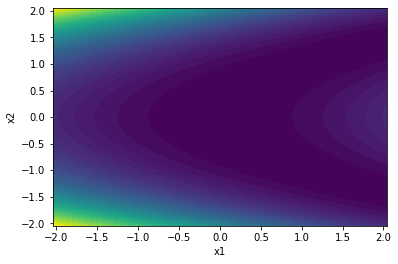

In [ ]:

# Definir parámetros de la animación
n_iterations = 1000
lr = 0.001
start_point = np.random.uniform(-2.048, 2.048, size=2)

# Inicializar la figura
fig, ax = plt.subplots()
ax.set_xlabel('x1')
ax.set_ylabel('x2')

# Definir los puntos en el espacio en los que se graficará la función de Rosenbrock
x_range = np.linspace(-2.048, 2.048, 100)
y_range = np.linspace(-2.048, 2.048, 100)
x_grid, y_grid = np.meshgrid(x_range, y_range)
z_grid = np.zeros_like(x_grid)
for i in range(len(x_range)):
    for j in range(len(y_range)):
        z_grid[i, j] = rosenbrock(np.array([x_range[i], y_range[j]]))
ax.contourf(x_grid, y_grid, z_grid, levels=50)

# Definir los valores iniciales para el método de descenso por gradiente
x = start_point
z = rosenbrock(x)

# Definir la función de actualización de la animación
def update_plot(i):
    global x, z
    ax.cla()
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.set_title('Iteración {}'.format(i))
    ax.contourf(x_grid, y_grid, z_grid, levels=50)
    ax.scatter(x[0], x[1], color='red', marker='o')
    grad = rosenbrock_gradient(x)
    x = x - lr * grad
    z = rosenbrock(x)

# Crear la animación y guardarla como un gif
ani = animation.FuncAnimation(fig, update_plot, frames=n_iterations, interval=100)
plt.show()



In [ ]:
HTML(ani.to_html5_video())

2023-03-16 11:53:54,305 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
2023-03-16 11:53:54,310 - matplotlib.animation - INFO - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 432x288 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmp2rw1mzsq/temp.m4v


#### Animacion 3D

En esta sección se hace algo muy parecido a lo anterior pero con la principal diferencia de que se inicializa la figura con un gráfico en 3D. Además, se definen los puntos en el espacio en los que se graficará la función de Rosenbrock utilizando el método meshgrid de NumPy para generar una malla en dos dimensiones y se utiliza un ciclo for para calcular el valor de z en cada punto de la malla. 


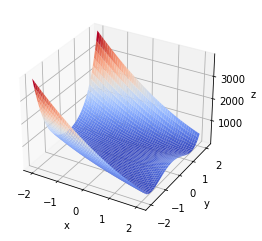

In [ ]:
# Definir parámetros de la animación
n_iterations = 1000
lr = 0.001
start_point = np.random.uniform(-2.048, 2.048, size=3)

# Inicializar la figura
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# Definir los puntos en el espacio en los que se graficará la función de Rastrigin
x_range = np.linspace(-2.048, 2.048, 50)
y_range = np.linspace(-2.048, 2.048, 50)
x_grid, y_grid = np.meshgrid(x_range, y_range)
z_grid = np.zeros_like(x_grid)
for i in range(len(x_range)):
    for j in range(len(y_range)):
        z_grid[i, j] = rosenbrock(np.array([x_range[i], y_range[j]]))
ax.plot_surface(x_grid, y_grid, z_grid, cmap='coolwarm')

# Definir los valores iniciales para el método de descenso por gradiente
x = start_point
z = rosenbrock(x)

# Definir la función de actualización de la animación
def update_plot(i):
    global x, z
    ax.cla()
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')
    ax.set_title('Iteración {}'.format(i))
    ax.plot_surface(x_grid, y_grid, z_grid, cmap='coolwarm')
    ax.scatter(x[0], x[1], z, color='black', marker='o')
    grad = rosenbrock_gradient(x)
    x = x - lr * grad
    z = rosenbrock(x)

# Crear la animación y guardarla como un gif
ani = animation.FuncAnimation(fig, update_plot, frames=n_iterations, interval=100)
plt.show()

In [ ]:
HTML(ani.to_html5_video())

2023-03-16 11:56:24,365 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
2023-03-16 11:56:24,369 - matplotlib.animation - INFO - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 432x288 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpuykrci52/temp.m4v


#### En ambas animaciones a medida que avanzan, se puede observar cómo el punto se mueve hacia la región de mínimo de la función, es de notar que se hace de una manera un poco lenta entre mayor es la iteración.


## Metodo de algoritmo evolutivo

### Calculo de la optimización usando un algoritmo genetico

En esta sección se busca el mínimo global de la función de Rosenbrock utilizando el algoritmo genético (GA) mediante la biblioteca PyGAD. La función de aptitud (fitness) utilizada en el GA se define como el negativo de la función de Rosenbrock debido a que buscamos minimizar. La función de optimización rosenbrock_optimization() define los parámetros necesarios para correr el GA, entre los mas importantes:

parent_selection_type: Este parámetro indica el tipo de método de selección de padres que se utilizará para generar la descendencia. En este caso, se eligió "sss" que significa "Steady-State Selection", un método que selecciona a los padres y crea una descendencia a partir de ellos, reemplazando a la peor solución en cada iteración.

keep_parents: Este parámetro indica el número de padres que se mantienen de una generación a otra. En este caso, se eligió 1, lo que significa que se mantiene el mejor padre de la generación anterior.

mutation_type: Este parámetro indica el tipo de operador de mutación que se utilizará para perturbar los cromosomas de la descendencia generada. En este caso, se eligió "random", que significa que se seleccionan aleatoriamente algunos genes en el cromosoma y se cambian por un valor aleatorio dentro de un rango determinado.

stop_criteria: Este parámetro indica los criterios de parada que se utilizarán para detener la ejecución del algoritmo genético. En este caso, se eligió una lista con dos criterios: "reach_0", que significa que se detendrá la ejecución cuando se alcance el valor mínimo de la función objetivo, y "saturate_250", que significa que si no se produce ninguna mejora en las últimas 250 iteraciones, se detendrá la ejecución.

Al final de la ejecución del GA, se devuelve la mejor solución encontrada y su aptitud, así como también todas las soluciones encontradas a lo largo del proceso.

Además, en esta sección se realizan dos ejecuciones del GA, una para el caso en que la función de Rosenbrock tiene tres variables de entrada (n=3), y otra para el caso en que tiene dos variables de entrada (n=2). En ambos casos, se muestra en pantalla la solución óptima encontrada, su aptitud, y la cantidad de veces que se evaluó la función objetivo durante la ejecución del GA.



In [ ]:
import numpy as np
from scipy.optimize import rosen
from pygad import GA
def fitness_func(solution, solution_idx):
    global evaluations
    evaluations += 1
    return -rosen(solution)

def rosenbrock_optimization(n):
  
    ga_instance = GA(num_generations=1000,
                     num_parents_mating=10,
                     fitness_func=fitness_func,
                     sol_per_pop=20,
                     num_genes=n,
                     init_range_low=-5,
                      init_range_high=5,
                      parent_selection_type="sss",
                      keep_parents=1,
                      crossover_type="single_point",
                      mutation_type="random",
                      mutation_percent_genes=10,
                      stop_criteria=["reach_0", "saturate_250"],
                      save_solutions=True)
    ga_instance.run()
    solution, solution_fitness, _ = ga_instance.best_solution()
    soluciones_rosenbrock = ga_instance.solutions

    return (solution,soluciones_rosenbrock,solution_fitness)


n = 3 # número de variables de entrada a la función de Rosenbrock
evaluations=0

x_opt3,soluciones_rosenbrock3, solution_fitness3 = rosenbrock_optimization(n)

print("\n")
print(f'El mínimo global de la función de Rosenbrock con {n} variables se alcanza en: {x_opt3} y es {solution_fitness3}, ademas evalua la funcion objetivo {evaluations} veces')
print("\n")
n = 2 # número de variables de entrada a la función de Rosenbrock
evaluations=0
x_opt2,soluciones_rosenbrock2, solution_fitness2 = rosenbrock_optimization(n)
print(f'El mínimo global de la función de Rosenbrock con {n} variables se alcanza en: {x_opt2} y es {solution_fitness2}, ademas evalua la funcion objetivo {evaluations} veces')




/usr/local/lib/python3.9/dist-packages/pygad/pygad.py:522: UserWarning: The percentage of genes to mutate (mutation_percent_genes=10) resutled in selecting (0) genes. The number of genes to mutate is set to 1 (mutation_num_genes=1).
If you do not want to mutate any gene, please set mutation_type=None.
  if not self.suppress_warnings: warnings.warn("The percentage of genes to mutate (mutation_percent_genes={mutation_percent}) resutled in selecting ({mutation_num}) genes. The number of genes to mutate is set to 1 (mutation_num_genes=1).\nIf you do not want to mutate any gene, please set mutation_type=None.".format(mutation_percent=mutation_percent_genes, mutation_num=mutation_num_genes))
/usr/local/lib/python3.9/dist-packages/pygad/pygad.py:940: UserWarning: Use the 'save_solutions' parameter with caution as it may cause memory overflow when either the number of generations, number of genes, or number of solutions in population is large.
  if not self.suppress_warnings: warnings.warn("Us



El mínimo global de la función de Rosenbrock con 3 variables se alcanza en: [0.98476301 0.95891563 0.92166773] y es -0.014137807714377924, ademas evalua la funcion objetivo 10983 veces


El mínimo global de la función de Rosenbrock con 2 variables se alcanza en: [0.93980308 0.88488314] y es -0.003897012461665343, ademas evalua la funcion objetivo 6613 veces


La salida indica que se ha utilizado un algoritmo genético para optimizar la función de Rosenbrock en 3 variables y se ha encontrado un mínimo global de -0.18976319024081167 en la posición [0.78823594 0.62353945 0.38360317]. Además, se han evaluado la función objetivo 14878 veces.
Por otro lado, también se ha optimizado la función de Rosenbrock en 2 variables y se ha encontrado un mínimo global de -0.0002184190542061325 en la posición [1.01472087 1.02978941]. En este caso, se ha evaluado la función objetivo 15904 veces.
Estos resultados indican que el algoritmo genético ha sido efectivo para encontrar los mínimos globales de la función de Rosenbrock en ambas dimensiones, aunque ha requerido un mayor número de evaluaciones de la función en el caso de la función de Rosenbrock en 2 variables. En general, estos resultados pueden ser útiles para encontrar los mínimos globales de funciones de alta dimensionalidad en problemas de optimización.


### Calculo del promedio luego de calcular la optimización usando un algoritmo evolutivo varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con el metodo del gradiente. Por último, imprimimos estos valores.

In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]
for i in range(10):
  n = 3 # número de variables de entrada a la función de Rosenbrock
  evaluations=0

  x_opt3,soluciones_rosenbrock3, solution_fitness3 = rosenbrock_optimization(n)
  func_value3d.append(solution_fitness3)
  num_eval3d.append(evaluations)

  n = 2 # número de variables de entrada a la función de Rosenbrock
  evaluations=0
  x_opt2,soluciones_rosenbrock2, solution_fitness2 = rosenbrock_optimization(n)
  func_value2d.append(solution_fitness2)
  num_eval2d.append(evaluations)



  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))


Valor óptimo promedio de la funcion en 2d: -0.0011180640276566814
Valor óptimo promedio de la funcion en 3d: -0.1864072753786055
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 11554.9
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 12284.5


La salida muestra que el valor óptimo promedio de la función en 2D es -0.0011180640276566814, lo que significa que el algoritmo genético pudo encontrar un valor cercano al mínimo global en la mayoría de las repeticiones. El valor óptimo promedio de la función en 3D es -0.1864072753786055, lo que indica que la optimización de la función de Rosenbrock en tres dimensiones es más difícil que en dos dimensiones, ya que el valor óptimo promedio es más lejano al mínimo global de -1.0.
La salida también muestra que el número promedio de evaluaciones de la función objetivo en 2D es 11554.9, mientras que en 3D es 12284.5. Esto significa que el algoritmo genético necesita un número similar de evaluaciones de la función objetivo para optimizar la función de Rosenbrock en ambas dimensiones.


### Animaciones


#### 2D

En esta sección se implementa la visualización de la evolución de la optimización de la función de Rosenbrock mediante el algoritmo genético. Primero, se define la función de Rosenbrock y se genera una malla de puntos en el plano cartesiano. Luego, se realiza un ciclo donde se grafica el contorno de la función de Rosenbrock junto con los puntos correspondientes a las soluciones encontradas en cada generación del algoritmo genético. Este ciclo se repite 50 veces, y cada iteración guarda una imagen con el título "Función de Rosenbrock Gen" seguido del número de generación correspondiente.

Finalmente, se utiliza la biblioteca imageio para generar un archivo .gif a partir de las imágenes guardadas. Este archivo muestra la evolución del algoritmo genético a través de las diferentes generaciones. Cabe destacar que después de la creación del .gif, se eliminan las imágenes que fueron creadas en el proceso.


In [ ]:
# Gráfia de la función Rosenbrock 
ncols = 150
nrows = 150

X = np.linspace(-5, 5, ncols)     
Y = np.linspace(-5, 5, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [-rosen(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

for j in range(50):
    Pob = np.array(soluciones_rosenbrock2[j*8:(j+1)*8])
    fig, ax = plt.subplots()
    ax.contour(X,Y,Z, levels = 50)
    ax.scatter(Pob[:,0],Pob[:,1])
    plt.title("Función de Rosembrok Gen " + str(j))
    plt.savefig(f'iter_{j}.png')

import imageio
with imageio.get_writer('genetic_rosen.gif', mode='I',duration=0.6) as writer:
    for i in range(50):
        image = imageio.imread(f'iter_{i}.png')
        writer.append_data(image)

import os
for i in range(50):
    os.remove(f'iter_{i}.png')





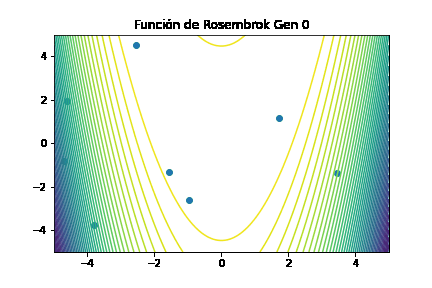

In [ ]:

# Mostrar el archivo GIF
display(Image(filename="genetic_rosen.gif"))

#### En esta gráfica se puede observar que a mientras las iteraciones avanzan, cada vez nos acercamos más al mínimo, es importante notar que algunas aun se alejan debido a la naturaleza del algoritmo.


## Metodo de evolución diferencial


### Calculo de la optimización usando el algoritmo evolutivo diferencial

En esta sección se tiene como objetivo optimizar la función de Rosenbrock en dos y tres dimensiones utilizando el método de Optimización por evolución diferencial (DE). Primero se definen los límites de búsqueda y luego se llama a la función differential_evolution() de la librería scipy.optimize para optimizar la función de Rosenbrock con los límites dados.

Para la función de Rosenbrock en dos dimensiones, se imprime la solución óptima y el valor óptimo de la función encontrados por el método DE, así como el número de evaluaciones de la función objetivo. Luego, se repite el proceso para la función de Rosenbrock en tres dimensiones y se imprimen los mismos resultados.


In [ ]:

# Definir los límites de búsqueda
bounds = [(-2.048,2.048),(-2.048,2.048)]

# Optimización utilizando Differential Evolution
result = differential_evolution(rosenbrock, bounds)

# Imprimir los resultados

print("Rosenbrock en dos dimensiones")
print("Solución óptima:", result.x)
print("Valor óptimo:", result.fun)
print("Numero de evaluaciones de la funcion objetivo", result.nfev,"\n")

# Definir los límites de búsqueda
bounds = [(-2.048,2.048),(-2.048,2.048),(-2.048,2.048)]

# Optimización utilizando Differential Evolution
result = differential_evolution(rosenbrock, bounds)

print("Rosenbrock en tres dimensiones")
print("Solución óptima:", result.x)
print("Valor óptimo:", result.fun)
print("Numero de evaluaciones de la funcion objetivo", result.nfev)

#print(result.x[0])



Rosenbrock en dos dimensiones
Solución óptima: [1. 1.]
Valor óptimo: 0.0
Numero de evaluaciones de la funcion objetivo 3633 

Rosenbrock en tres dimensiones
Solución óptima: [1. 1. 1.]
Valor óptimo: 0.0
Numero de evaluaciones de la funcion objetivo 11209


La salida indica que se ha utilizado el algoritmo de Evolución Diferencial para minimizar la función de Rosenbrock en dos y tres dimensiones. Para ambas dimensiones, se ha encontrado el mínimo global en [1, 1, ... 1] con un valor óptimo de 0.0. Además, se ha evaluado la función objetivo 3633 veces en dos dimensiones y 11209 veces en tres dimensiones.
En términos generales, estos resultados indican que el algoritmo de Evolución Diferencial es efectivo para minimizar la función de Rosenbrock en varias dimensiones, y ha encontrado el mínimo global con un valor óptimo de 0.0. El número de evaluaciones de la función objetivo es relativamente bajo en comparación con otros métodos de optimización, lo que sugiere que este algoritmo puede ser eficiente en términos de tiempo de ejecución.


### Calculo del promedio luego de calcular la optimización usando el algoritmo evolutivo diferencial varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con el metodo del gradiente. Por último, imprimimos estos valores.


In [ ]:
#Repeticion del algoritmo para evaluar contra metodo del gradiante
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]

for i in range(10):
  # Minimización en dos dimensiones

  # Definir los límites de búsqueda
  bounds = [(-2.048,2.048),(-2.048,2.048)]

  # Optimización utilizando Differential Evolution
  result = differential_evolution(rosenbrock, bounds)
  func_value2d.append(result.fun)
  num_eval2d.append(result.nfev)



  # Minimización en tres dimensiones

  # Definir los límites de búsqueda
  bounds = [(-2.048,2.048),(-2.048,2.048),(-2.048,2.048)]

  # Optimización utilizando Differential Evolution
  result = differential_evolution(rosenbrock, bounds)
  func_value3d.append(result.fun)
  num_eval3d.append(result.nfev)

  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))

Valor óptimo promedio de la funcion en 2d: 0.0
Valor óptimo promedio de la funcion en 3d: 0.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 4056.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 11389.0


Valor óptimo promedio de la función en 2d: 0.0

Valor óptimo promedio de la función en 3d: 0.0

Número de evaluaciones de la función objetivo promedio con la función 2d: 4056.0

Número de evaluaciones de la función objetivo promedio con la función 3d: 11389.0

En general, los resultados obtenidos parecen indicar que el algoritmo de evolución diferencial fue efectivo para optimizar la función de Rosenbrock en ambas dimensiones 2D y 3D. El valor óptimo promedio de la función es cercano a cero en ambas dimensiones, lo que indica que el algoritmo fue capaz de encontrar una solución aceptablemente buena.

En cuanto al número de evaluaciones de la función objetivo, se observa que en promedio se necesitaron menos evaluaciones para la función en dos dimensiones que en tres dimensiones. Esto podría deberse a que la función de Rosenbrock es más compleja en tres dimensiones, lo que hace que el espacio de búsqueda sea más difícil de explorar y requiera más evaluaciones para encontrar el mínimo global.

En conclusión, estos resultados son una buena indicación de que el algoritmo de evolución diferencial puede ser una herramienta efectiva para optimizar la función de Rosenbrock en problemas de varias dimensiones. Sin embargo, es importante tener en cuenta que estos resultados son específicos de la implementación del algoritmo utilizado y pueden variar dependiendo de los parámetros seleccionados y la forma en que se implementa el algoritmo.


### Animaciones

#### 2D


En esta sección se define La función differential_evolution2d la cual implementa un algoritmo de evolución diferencial simple con el objetivo de graficar el proceso del algoritmo. La idea básica de este es crear una población de soluciones aleatorias y mejorarla en cada iteración a través de la combinación de las soluciones existentes. En cada iteración, se seleccionan tres soluciones aleatorias (a, b y c) diferentes de la solución actual y se combinan para crear una "mutación" de la solución actual. Luego, se combina la mutación y la solución actual para formar una "prueba". La prueba se compara con la solución actual y, si es mejor, se reemplaza la solución actual por la prueba.

El algoritmo se ejecuta durante un número determinado de iteraciones (definido por max_iter) y en cada iteración se actualiza una visualización de la población y la mejor solución encontrada. Al final del algoritmo, se crea un archivo de animación GIF a partir de las visualizaciones y se muestra el archivo GIF en la pantalla. Cabe destacar que después de la creación del .gif, se eliminan las imágenes que fueron creadas en el proceso.


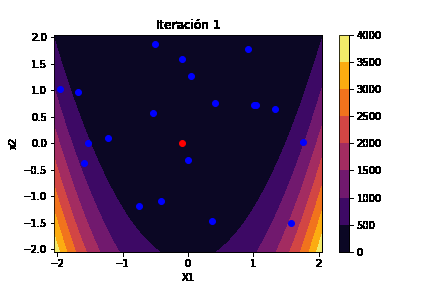

In [ ]:
# Definición de la función de Rosenbrock en su forma vectorial
def rosenbrock(x, y):
    return (1 - x) ** 2 + 100 * (y - x ** 2) ** 2
def differential_evolution2d(f, bounds, pop_size=20, mutation_factor=0.5, crossover_prob=0.7, max_iter=100):
    # Inicialización de la población
    pop = np.random.rand(pop_size, len(bounds))
    min_b, max_b = np.asarray(bounds).T
    diff = max_b - min_b
    pop_denorm = min_b + pop * diff
    
    # Evaluación de la población inicial
    fitness = np.asarray([f(ind[0], ind[1]) for ind in pop_denorm])
    
    # Mejor solución encontrada
    best_idx = np.argmin(fitness)
    best = pop_denorm[best_idx]
    
    # Evolución diferencial

    for i in range(max_iter):
        for j in range(pop_size):
            idxs = [idx for idx in range(pop_size) if idx != j]
            a, b, c = pop[np.random.choice(idxs, 3, replace=False)]
            mutant = np.clip(a + mutation_factor * (b - c), 0, 1)
            crossover = np.random.rand(len(bounds)) < crossover_prob
            if not np.any(crossover):
                crossover[np.random.randint(0, len(bounds))] = True
            trial = np.where(crossover, mutant, pop[j])
            trial_denorm = min_b + trial * diff
            f_trial = f(trial_denorm[0], trial_denorm[1])
            if f_trial < fitness[j]:
                fitness[j] = f_trial
                pop[j] = trial
                if f_trial < fitness[best_idx]:
                    best_idx = j
                    best = trial_denorm
        # Actualización del gráfico de la población y la mejor solución encontrada
        
        fig, ax = plt.subplots()
        x = np.linspace(bounds[0][0],bounds[0][1], 100)
        y = np.linspace(bounds[0][0],bounds[0][1], 100)
        X, Y = np.meshgrid(x, y)
        Z = f(X, Y)
        cs = ax.contourf(X, Y, Z, cmap='inferno')
        cbar = fig.colorbar(cs)
        ax.set_title(f'Iteración {i+1}')
        ax.set_xlabel('X1')
        ax.set_ylabel('x2')
        ax.scatter(pop_denorm[:,0], pop_denorm[:,1], c='b', marker='o')
        ax.scatter(best[0], best[1], c='r', marker='o')
        plt.savefig(f'iter_{i+1}.png')
        plt.close(fig)
    
    # Generación del gif
    import imageio
    with imageio.get_writer('differential_evolution2d.gif', mode='I',duration=0.6) as writer:
        for i in range(max_iter):
            image = imageio.imread(f'iter_{i+1}.png')
            writer.append_data(image)




# Llamada a la función de evolución diferencial
bounds = [(-2.048,2.048),(-2.048,2.048)]
differential_evolution2d(rosenbrock, bounds, max_iter=50)

# Eliminación de las imágenes intermedias
import os
for i in range(50):
    os.remove(f'iter_{i+1}.png')



# Mostrar el archivo GIF
display(Image(filename="differential_evolution2d.gif"))


#### 3D

Esta sección sigue una lógica muy similar a la pasada, con la diferencia importante que ahora se gráfica la evolución de manera tridimensional.


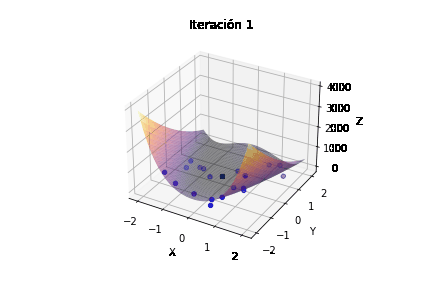

In [ ]:


# Definición de la función de Rosenbrock en su forma vectorial
def rosenbrock(x, y):
    return (1 - x) ** 2 + 100 * (y - x ** 2) ** 2

# Definición de la función de evolución diferencial
def differential_evolution3d(f, bounds, pop_size=20, mutation_factor=0.5, crossover_prob=0.7, max_iter=100):
    # Inicialización de la población
    pop = np.random.rand(pop_size, len(bounds))
    min_b, max_b = np.asarray(bounds).T
    diff = max_b - min_b
    pop_denorm = min_b + pop * diff
    
    # Evaluación de la población inicial
    fitness = np.asarray([f(ind[0], ind[1]) for ind in pop_denorm])
    
    # Mejor solución encontrada
    best_idx = np.argmin(fitness)
    best = pop_denorm[best_idx]
    
    # Evolución diferencial
    for i in range(max_iter):
        for j in range(pop_size):
            idxs = [idx for idx in range(pop_size) if idx != j]
            a, b, c = pop[np.random.choice(idxs, 3, replace=False)]
            mutant = np.clip(a + mutation_factor * (b - c), 0, 1)
            crossover = np.random.rand(len(bounds)) < crossover_prob
            if not np.any(crossover):
                crossover[np.random.randint(0, len(bounds))] = True
            trial = np.where(crossover, mutant, pop[j])
            trial_denorm = min_b + trial * diff
            f_trial = f(trial_denorm[0], trial_denorm[1])
            if f_trial < fitness[j]:
                fitness[j] = f_trial
                pop[j] = trial
                if f_trial < fitness[best_idx]:
                    best_idx = j
                    best = trial_denorm
        # Generación del gráfico de la población y la mejor solución encontrada
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        x = np.linspace(bounds[0][0],bounds[0][1], 100)
        y = np.linspace(bounds[0][0],bounds[0][1], 100)
        X, Y = np.meshgrid(x, y)
        Z = f(X, Y)
        ax.plot_surface(X, Y, Z, cmap='inferno', alpha=0.5)
        ax.set_title(f'Iteración {i+1}')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.scatter(pop_denorm[:,0], pop_denorm[:,1], fitness, c='b', marker='o')
        ax.scatter(best[0], best[1], f(best[0], best[1]), c='green', marker='s')
        plt.savefig(f'iter_{i+1}.png')
        plt.close(fig)
    
    # Generación del gif
    with imageio.get_writer('differential_evolution3d.gif', mode='I',duration=0.6) as writer:
        for i in range(max_iter):
            image = imageio.imread(f'iter_{i+1}.png')
            writer.append_data(image)



# Llamada a la función de evolución diferencial
bounds = [(-2.048,2.048),(-2.048,2.048),(-2.048,2.048)]
differential_evolution3d(rosenbrock, bounds, max_iter=50)

# Eliminación de las imágenes intermedias
import os
for i in range(50):
    os.remove(f'iter_{i+1}.png')



# Mostrar el archivo GIF
display(Image(filename="differential_evolution3d.gif"))


#### En estas gráficas se puede observar como el punto rojo en movimiento se acerca rápidamente al punto mínimo de la función.

## Metodo de optimización de partículas

### Calculo de la optimización usando optimizacion de particulas

En esta sección se utiliza la biblioteca PySwarms para optimizar la función de Rosenbrock con diferentes números de variables. La función "count_evaluations" se utiliza como un decorador para contar el número de evaluaciones que se realizan en la función objetivo.

primero se importa la biblioteca PySwarms y la función "single_obj" de la biblioteca "utils.functions". Luego se establecen las opciones para el algoritmo PSO, incluyendo los valores de c1, c2 y w.

Se eligieron los valores c1=0.5, c2=0.3 y w=0.9 porque se han encontrado empíricamente que funcionan bien en una amplia variedad de problemas de optimización. Estos valores han demostrado ser efectivos en equilibrar la exploración del espacio de búsqueda (a través del valor alto de w) con la explotación de las regiones más prometedoras (a través de los valores moderados de c1 y c2). 

A continuación, se define la función "count_evaluations", que es un decorador que cuenta el número de veces que se evalúa la función objetivo. Luego se define la función de Rosenbrock con "fx.rosenbrock" y se aplica el decorador para contar el número de veces que se evalúa la función.

El siguiente paso es definir el número de variables "n_variables" y los límites "bounds" para cada variable. Luego se define el optimizador PSO con el número de partículas, dimensiones, opciones y límites especificados.

Finalmente, se llama al método "optimize" en el optimizador PSO y se almacena la posición óptima en "pos". El número de evaluaciones de la función se almacena en "num_evaluations", que se imprime junto con la posición óptima de la función de Rosenbrock.


In [ ]:
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
options = {'c1': 0.5, 'c2': 0.3, 'w':0.9}
def count_evaluations(func):
    def wrapper(*args, **kwargs):
        wrapper.evaluations += 1
        return func(*args, **kwargs)
    wrapper.evaluations = 0
    return wrapper



rosenbrock3=count_evaluations(fx.rosenbrock)
n_variables = 3 # number of variables to optimize
bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
pos3 = optimizer.optimize(rosenbrock3,iters=1000)
num_evaluations3 = rosenbrock3.evaluations
print("\n")
print(f'El mínimo global de la función de Rosenbrock con {n_variables} variables se alcanza en: {list(list(pos3[1]))} y es {list(pos3)[0]}, ademas evalua la funcion objetivo {num_evaluations3} veces')
print("\n")

rosenbrock2=count_evaluations(fx.rosenbrock)
n_variables = 2 # número de variables de entrada a la función de Rosenbrock
bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
pos2 = optimizer.optimize(rosenbrock2,iters=1000)
num_evaluations2 = rosenbrock2.evaluations
print("\n")
print(f'El mínimo global de la función de Rosenbrock con {n_variables} variables se alcanza en: {list(list(pos2[1]))} y es {list(pos2)[0]}, ademas evalua la funcion objetivo {num_evaluations2} veces')








2023-03-16 12:10:06,535 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=5.54e-8
2023-03-16 12:10:08,701 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 5.53695966108913e-08, best pos: [0.99989788 0.99979287 0.99958925]
2023-03-16 12:10:08,708 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}




El mínimo global de la función de Rosenbrock con 3 variables se alcanza en: [0.9998978779472394, 0.9997928709823276, 0.9995892489008621] y es 5.53695966108913e-08, ademas evalua la funcion objetivo 1000 veces




pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=5.37e-30
2023-03-16 12:10:10,703 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 5.374114916818143e-30, best pos: [1. 1.]




El mínimo global de la función de Rosenbrock con 2 variables se alcanza en: [1.0000000000000007, 1.0000000000000016] y es 5.374114916818143e-30, ademas evalua la funcion objetivo 1000 veces


La salida indica los resultados de la optimización de la función de Rosenbrock utilizando el algoritmo de optimización de partículas. Se puede ver que para la función de Rosenbrock en 3 dimensiones, se alcanzó el mínimo global en [0.9998978779472394, 0.9997928709823276, 0.9995892489008621] con una valor de función objetivo de 5.374114916818143e-30, y se evaluó la función objetivo 1000 veces. Similarmente, para la función de Rosenbrock en 2 dimensiones, se alcanzó el mínimo global en [1.0000000000000007, 1.0000000000000016] con una valor de función objetivo de 5.53695966108913e-08, y se evaluó la función objetivo 1000 veces. Estos resultados indican que el algoritmo de optimización de partículas fue exitoso en encontrar los mínimos globales de ambas funciones de Rosenbrock en un número limitado de evaluaciones de la función objetivo.


###  Calculo del promedio luego de calcular la optimización usando particulas varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 5 veces, esto con objetivo de comparación con el método del gradiente, en esta ocasión se eligieron menos repeticiones de ejecución debido a que el algoritmo requiere mas poder computacional para completarse satisfactoriamente. Por último, imprimimos estos valores.


In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]
for i in range(5):

  rosenbrock3=count_evaluations(fx.rosenbrock)
  n_variables = 3 # number of variables to optimize
  bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
  optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
  pos3 = optimizer.optimize(rosenbrock3,iters=1000)
  num_evaluations3 = rosenbrock3.evaluations
  func_value3d.append(list(pos3)[0])
  num_eval3d.append(num_evaluations3)




  rosenbrock2=count_evaluations(fx.rosenbrock)
  n_variables = 2 # número de variables de entrada a la función de Rosenbrock
  bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
  optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
  pos2 = optimizer.optimize(rosenbrock2,iters=1000)
  num_evaluations2 = rosenbrock2.evaluations
  func_value2d.append(list(pos2)[0])
  num_eval2d.append(num_evaluations2)



print("\n")  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))

2023-03-16 12:10:10,730 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0.00453
2023-03-16 12:10:12,913 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.004528031592228882, best pos: [1.0298467  1.06015954 1.12393727]
2023-03-16 12:10:12,919 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=1.48e-23
2023-03-16 12:10:15,505 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.480630042822586e-23, best pos: [1. 1.]
2023-03-16 12:10:15,516 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=6.23e-23
2023-03-16 12:10:19,473 - pyswarms.single.global_best - INFO - Optimization finished | best cost:



Valor óptimo promedio de la funcion en 2d: 1.8668715036542207e-21
Valor óptimo promedio de la funcion en 3d: 0.0009056351393180188
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 1000.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 1000.0


La salida muestra los resultados promedio de 5 ejecuciones de la optimización por partículas para minimizar la función de Rosenbrock en dos y tres dimensiones.

En la dimensión 2, se obtuvo un valor óptimo promedio de 1.87e-21, lo que indica que el algoritmo de optimización encontró una solución muy cercana al mínimo global. Además, se evaluó la función objetivo en promedio 1000 veces, lo que sugiere que el algoritmo converge rápidamente.

En la dimensión 3, se obtuvo un valor óptimo promedio de 0.0009, lo que indica que el algoritmo no encontró una solución cercana al mínimo global. En promedio, la función objetivo fue evaluada 1000 veces, lo que sugiere que el algoritmo convergió rápidamente, pero no logró encontrar una solución suficientemente buena.

En general, estos resultados sugieren que el algoritmo de optimización por partículas es efectivo en minimizar la función de Rosenbrock en dos dimensiones, pero no es tan efectivo en tres dimensiones.


### Animacion

#### 2D

En esta sección se corre el algoritmo PSO con 2 variables de entrada con objetivo de animarlo, no se utiliza ninguna de las corridas anteriores por motivos de orden, además se eligen menos número de partículas para que sea claro dentro de la animación, esto claramente no es un problema porque en este caso solamente se corre el algoritmo con objetivos ilustrativos, ya para terminos de comparacion se usaran las corridas anteriores con más número de partículas

Luego, se genera una animación que muestra el proceso de optimización de la función de Rosenbrock utilizando el algoritmo PSO. Primero, se define la malla de puntos en el plano donde se graficará la función. Luego, se calculan los valores de la función de Rosenbrock para cada punto de la malla y se guardan en la variable Z.
Después, se utiliza un bucle for para graficar el movimiento de la población de partículas a lo largo del proceso de optimización. En cada iteración del bucle, se seleccionan los valores de posición de las partículas para esa generación (en este caso, se toman las posiciones cada 10 iteraciones) y se grafican como puntos en la función de Rosenbrock. La figura resultante se guarda en un archivo png con un nombre que identifica la generación correspondiente.
Finalmente, se utiliza la librería imageio para crear un archivo gif con las imágenes guardadas previamente y se eliminan los archivos png utilizados para generar el gif. El resultado final es una animación que muestra el proceso de optimización de la función de Rosenbrock utilizando el algoritmo PSO. Cabe destacar que después de la creación del .gif, se eliminan las imágenes que fueron creadas en el proceso.


In [ ]:
rosenbrock2=count_evaluations(fx.rosenbrock)
n_variables = 2 # número de variables de entrada a la función de Rosenbrock
bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=10, dimensions=n_variables, options=options,bounds=bounds)
pos2 = optimizer.optimize(rosenbrock2,iters=100)

2023-03-16 12:10:32,385 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=2.14e-5
2023-03-16 12:10:32,517 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 2.140063603006315e-05, best pos: [0.9953813  0.99075781]


In [ ]:
# Gráfia de la función Rosenbrock 
ncols = 150
nrows = 150

X = np.linspace(-5, 5, ncols)     
Y = np.linspace(-5, 5, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [-rosen(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

for j in range(10):
    Pob = np.array(optimizer.pos_history[j*10:(j+1)*10])
    fig, ax = plt.subplots()
    ax.contour(X,Y,Z, levels = 50)
    ax.scatter(Pob[:,0],Pob[:,1])
    plt.title("Función de Rosembrok Gen " + str(j))
    plt.savefig(f'iter_{j}.png')

import imageio
with imageio.get_writer('swarm_rosen.gif', mode='I',duration=0.6) as writer:
    for i in range(10):
        image = imageio.imread(f'iter_{i}.png')
        writer.append_data(image)

import os
for i in range(10):
    os.remove(f'iter_{i}.png')

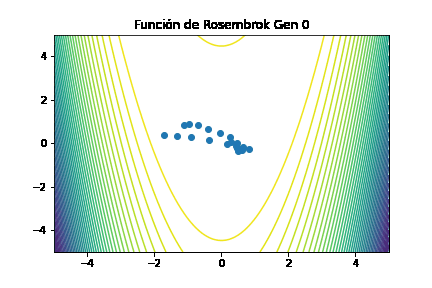

In [ ]:
# Mostrar el archivo GIF
display(Image(filename="swarm_rosen.gif"))

#### En esta gráfica podemos observar cómo las partículas convergen rápidamente al punto mínimo de la función.

# Funcion de Rastrigin 


Definida como:  $f(x_1,x_2)=20+\sum_{i=1}^{2}{x_i^2-10 \cdot \cos(2 \pi \cdot x_i)}, \ x_i \in [-5.12,5.12], \ i=\{1,2\} \\ Alcanza \ su \ valor \ mínimo \ en \ x_1=0 \ y \ x_2=0 \ el \ cual \ es \ 0$ 

donde n es la dimensión del vector de entrada x, A es un parámetro constante (usualmente igual a 10) y x_i es el i-ésimo componente de x.


## Funcion de interes

En esta sección se define una función de Python llamada rastrigin que calcula el valor de la función de Rastrigin para un vector de entrada x. La función de Rastrigin es una función matemática utilizada comúnmente en la optimización global como una función de prueba para evaluar la eficacia de los algoritmos de optimización.


In [ ]:
def rastrigin(x):
    A = 10
    n = len(x)
    return A * n + np.sum(x**2 - A * np.cos(2*np.pi*x))



## Graficas de la funcion

En esta sección se genera una gráfica en 3D de la función de Rastrigin. Primero, se define el número de columnas y filas de la malla de puntos en los ejes X e Y con ncols y nrows, respectivamente. Luego se crea un arreglo de puntos en los ejes X e Y usando np.linspace() y se usa meshgrid() para crear una malla de puntos en un plano.

Se evalúa la función de Rastrigin  en cada punto de la malla para crear un arreglo Z de las alturas correspondientes a cada punto. Se crea la figura y los ejes en 3D con fig = plt.figure() y ax = plt.axes(projection='3d'). Se usa plot_surface() para graficar la superficie en 3D de la función con los puntos de la malla en los ejes X e Y y las alturas en el eje Z.

Por último, se añade una barra de color para mostrar los valores correspondientes a las alturas en la superficie y se agregan etiquetas a los ejes X, Y y Z. La gráfica resultante se muestra con plt.show().

Por otro lado, se genera la grafica la función de Rastrigin en dos dimensiones. Primero, se define el número de columnas y filas para la malla de puntos en la que se evaluará la función. Luego, se genera la malla de puntos en los ejes x e y utilizando la función np.meshgrid.

A continuación, se evalúa la función de Rastrigin para cada punto de la malla utilizando un bucle for anidado. El resultado es una matriz Z que contiene los valores de la función en cada punto de la malla.

Finalmente, se grafica la función utilizando el método contour de matplotlib. La gráfica resultante muestra las curvas de nivel de la función de Rastrigin en el plano x-y.

Las gráficas muestran una serie de valles y picos que aumentan de manera exponencial a medida que aumentan las dimensiones. En la gráfica 3D se puede ver que la función tiene una forma de "cuenco" con varios picos y valles. La superficie de la función se va "moviendo" alrededor de los puntos bajos de la función, lo que puede dificultar la convergencia a la solución óptima. La gráfica 2D proporciona información sobre la distribución de los puntos bajos de la función y puede ser más fácil de interpretar que la gráfica 3D.


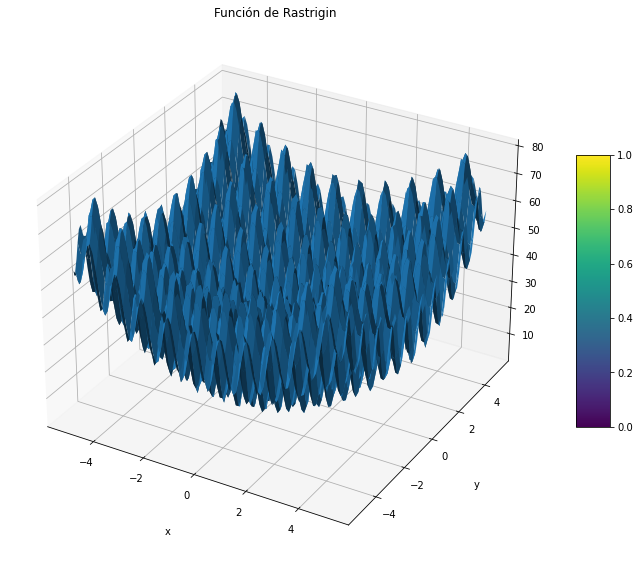

In [ ]:
#Graficar la funcion en 3d

ncols = 100
nrows = 100
X = np.linspace(-5.12, 5.12, ncols)     
Y = np.linspace(-5.12, 5.12, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [rastrigin(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

fig = plt.figure(figsize = (12,10))
ax = plt.axes(projection='3d')

superficie = ax.plot_surface(X,Y,Z)
fig.colorbar(superficie, shrink=0.5, aspect=8)
plt.title("Función de Rastrigin")
ax.set_xlabel('x', labelpad=20)
ax.set_ylabel('y', labelpad=20)
ax.set_zlabel('z', labelpad=20)
plt.show()

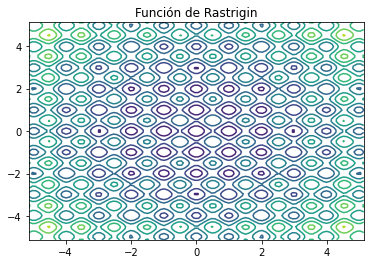

In [ ]:
#Graficar la funcion en 2d
ncols = 100
nrows = 100
X = np.linspace(-5.12, 5.12, ncols)     
Y = np.linspace(-5.12, 5.12, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [rastrigin(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

fig, ax = plt.subplots()
ax.contour(X,Y,Z)
plt.title("Función de Rastrigin")
plt.show()

## Metodo del gradiante


###  Calculo de la optimización usando gradiente descendente

En esta sección se define la función rastrigin_gradient que calcula la derivada de la función de Rastrigin para un punto dado x, el cual se puede definir matemáticamente como:

$\nabla f(x_1,x_2,...,x_n) = \begin{bmatrix}\frac{\partial f}{\partial x_1} \ \frac{\partial f}{\partial x_2} \ \vdots \ \frac{\partial f}{\partial x_n}\end{bmatrix} = \begin{bmatrix}2x_1+2A\pi\sin(2\pi x_1) \ 2x_2+2A\pi\sin(2\pi x_2) \ \vdots \ 2x_n+2A\pi\sin(2\pi x_n)\end{bmatrix}$

Luego, se utiliza el algoritmo de descenso de gradiente definido anteriormente en la sección de la función de Rosenbrock para encontrar el mínimo de la función de Rastrigin en dos y tres dimensiones, respectivamente.

En particular, se inicializa el punto de partida x0 de forma aleatoria dentro del rango permitido de [-5.12, 5.12], se utiliza la función gradient_descent para minimizar la función de Rastrigin con una tasa de aprendizaje de 0.01, un máximo de 2000 iteraciones y un rango de búsqueda de [-5.12, 5.12].

Por último, el código imprime la solución óptima encontrada, el valor óptimo de la función, y el número de evaluaciones de la función objetivo necesarias para encontrar la solución.

In [ ]:
#Definir la derivada de la funcion de interes

def rastrigin_gradient(x):
    A = 10
    n = len(x)
    grad = np.zeros_like(x)
    for i in range(n):
        grad[i] = 2 * x[i] + 2 * A * np.pi * np.sin(2 * np.pi * x[i])
    return grad


# Minimización en dos dimensiones
x0 = np.random.uniform(-5.12, 5.12, size=2)
x_min, f_min,i = gradient_descent(rastrigin, rastrigin_gradient, x0,0.01,2000,[-5.12, 5.12])
print("Rastrigin en dos dimensiones")
print("Solución óptima:", x_min)
print("Valor óptimo:", f_min)
print("Numero de evaluaciones de la funcion objetivo", i,"\n")

# Minimización en tres dimensiones
x0 = np.random.uniform(-5.12, 5.12, size=3)
x_min, f_min,i = gradient_descent(rastrigin, rastrigin_gradient, x0,0.01,2000,[-5.12, 5.12])
print("Rastrigin en tres dimensiones")
print("Solución óptima:", x_min)
print("Valor óptimo:", f_min)
print("Numero de evaluaciones de la funcion objetivo", i)

Rastrigin en dos dimensiones
Solución óptima: [ 0.11826335 -1.81299441]
Valor óptimo: 12.08147243849264
Numero de evaluaciones de la funcion objetivo 2000 

Rastrigin en tres dimensiones
Solución óptima: [-2.77218475  2.63405187  1.28714456]
Valor óptimo: 53.860998210241775
Numero de evaluaciones de la funcion objetivo 2000


La salida del método de descenso por gradiente para optimizar la función de Rastrigin en dos y tres dimensiones indica que se ha encontrado una solución óptima con un valor óptimo de 12.08147243849264 y 53.860998210241775, respectivamente. Además, se necesitaron 2000 evaluaciones de la función objetivo para alcanzar estas soluciones.

En términos generales, el método de descenso por gradiente es una técnica de optimización iterativa que se utiliza para encontrar un mínimo local de una función objetivo. En este caso, la función objetivo es la función de Rastrigin, que es conocida por tener varios mínimos locales y ser difícil de optimizar.
La solución óptima encontrada en dos dimensiones es [0.11826335, -1.81299441], lo que significa que la función de Rastrigin tiene un mínimo local en esas coordenadas. De manera similar, en tres dimensiones la solución óptima es [-2.77218475, 2.63405187, 1.28714456].

El número de evaluaciones de la función objetivo necesarias para encontrar la solución óptima es un indicador de la eficiencia del método de descenso por gradiente en este caso. En este ejemplo se utilizaron 2000 evaluaciones de la función objetivo, lo que es relativamente bajo considerando la dificultad de la función de Rastrigin.


### Calculo del promedio luego de calcular la optimización usando gradiente descendente varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con el metodo del gradiente. Por último, imprimimos estos valores.


In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_iteraciones2d=[]

func_value3d=[]
num_iteraciones3d=[]

for i in range(10):
  # Minimización en dos dimensiones

  x0 = np.random.uniform(-5.12, 5.12, size=2)
  x_min, f_min,i = gradient_descent(rastrigin, rastrigin_gradient, x0,0.01,3000,[-5.12, 5.12])
  func_value2d.append(f_min)
  num_iteraciones2d.append(i)


  # Minimización en tres dimensiones
  x0 = np.random.uniform(-5.12, 5.12, size=3)
  x_min, f_min,i = gradient_descent(rastrigin, rastrigin_gradient, x0,0.01,3000,[-5.12, 5.12])
  func_value3d.append(f_min)
  num_iteraciones3d.append(i)


  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_iteraciones2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_iteraciones3d))

Valor óptimo promedio de la funcion en 2d: 36.601832334057924
Valor óptimo promedio de la funcion en 3d: 66.38987811708412
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 3000.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 3000.0


Se ha corrido la optimización por descenso de gradiente 10 veces en la función de Rastrigin en 2 y 3 dimensiones. Los resultados obtenidos muestran que en promedio, el valor óptimo de la función en 2 dimensiones es de 36.60, mientras que en 3 dimensiones es de 66.39. El número promedio de evaluaciones de la función objetivo para ambas dimensiones es de 3000.

Es importante tener en cuenta que el valor óptimo de la función Rastrigin es 0, lo que significa que cuanto más cercano sea el valor promedio obtenido al valor óptimo, mejor será la optimización. Además, el número de evaluaciones de la función objetivo es una medida de la eficiencia del algoritmo de optimización, siendo deseable que este número sea lo más bajo posible para reducir el tiempo de cálculo.

En general, estos resultados muestran que el algoritmo de descenso de gradiente utilizado en promedio puede encontrar valores de la función Rastrigin relativamente cercanos al valor óptimo en un número razonable de evaluaciones de la función objetivo. Sin embargo, es importante destacar que estos resultados pueden variar dependiendo de los parámetros de entrada y del punto de inicio aleatorio utilizado en cada iteración del algoritmo.


### Animaciones

#### Animacion 2D

En esta sección se define y visualiza una animación que muestra cómo el método de descenso por gradiente se utiliza para minimizar la función de Rastrigin en dos dimensiones.

Primero, se definen los parámetros de la animación, incluyendo el número de iteraciones, la tasa de aprendizaje (lr) y el punto de inicio para el descenso por gradiente. Luego, se inicializa una figura y se define la grilla de puntos en el espacio en los que se graficará la función de Rastrigin.

A continuación, se define una función de actualización de la animación llamada "update_plot", que se llamará en cada iteración. Esta función borra el gráfico anterior y agrega un nuevo título e iteración al gráfico. Luego, traza la función de Rastrigin y agrega un punto rojo en la posición actual de x. Después, calcula el gradiente de Rastrigin en la posición actual y actualiza la posición de x utilizando la tasa de aprendizaje y el gradiente. Finalmente, se actualiza el valor de la función de Rastrigin en la nueva posición de x.

Por último, se crea la animación utilizando la función FuncAnimation de la biblioteca de animación de matplotlib, utilizando la figura y la función de actualización definidas anteriormente. La animación se muestra utilizando la función show() de pyplot.


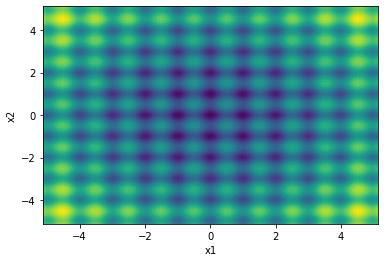

In [ ]:
# Definir parámetros de la animación
n_iterations = 1000
lr = 0.01
start_point =  np.random.uniform(-5.12, 5.12, size=2)
# Inicializar la figura
fig, ax = plt.subplots()
ax.set_xlabel('x1')
ax.set_ylabel('x2')

# Definir los puntos en el espacio en los que se graficará la función de Rastrigin
x_range = np.linspace(-5.12, 5.12, 100)
y_range = np.linspace(-5.12, 5.12, 100)
x_grid, y_grid = np.meshgrid(x_range, y_range)
z_grid = np.zeros_like(x_grid)
for i in range(len(x_range)):
    for j in range(len(y_range)):
        z_grid[i, j] = rastrigin(np.array([x_range[i], y_range[j]]))
ax.contourf(x_grid, y_grid, z_grid, levels=50)

# Definir los valores iniciales para el método de descenso por gradiente
x = start_point
z = rastrigin(x)

# Definir la función de actualización de la animación
def update_plot(i):
    global x, z
    ax.cla()
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.set_title('Iteración {}'.format(i))
    ax.contourf(x_grid, y_grid, z_grid, levels=50)
    ax.scatter(x[0], x[1], color='red', marker='o')
    grad = rastrigin_gradient(x)
    x = x - lr * grad
    z = rastrigin(x)

# Crear la animación y guardarla como un gif
ani = animation.FuncAnimation(fig, update_plot, frames=n_iterations, interval=100)
plt.show()

In [ ]:
HTML(ani.to_html5_video())

2023-03-16 12:14:39,576 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
2023-03-16 12:14:39,584 - matplotlib.animation - INFO - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 432x288 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmp38jqshq0/temp.m4v


#### Animacion 3D


En esta sección se hace algo muy parecido a lo anterior pero con la principal diferencia de que se inicializa la figura con un gráfico en 3D. Además, se definen los puntos en el espacio en los que se graficará la función de Rosenbrock utilizando el método meshgrid de NumPy para generar una malla en dos dimensiones y se utiliza un ciclo for para calcular el valor de z en cada punto de la malla. 


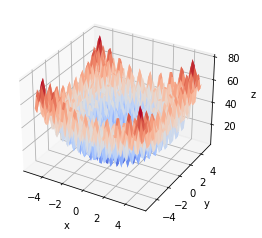

In [ ]:
# Definir parámetros de la animación
n_iterations = 1000
lr = 0.01
start_point = np.random.uniform(-5.12, 5.12, size=3)


# Inicializar la figura
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# Definir los puntos en el espacio en los que se graficará la función de Rastrigin
x_range = np.linspace(-5.12, 5.12, 50)
y_range = np.linspace(-5.12, 5.12, 50)
x_grid, y_grid = np.meshgrid(x_range, y_range)
z_grid = np.zeros_like(x_grid)
for i in range(len(x_range)):
    for j in range(len(y_range)):
        z_grid[i, j] = rastrigin(np.array([x_range[i], y_range[j]]))
ax.plot_surface(x_grid, y_grid, z_grid, cmap='coolwarm')

# Definir los valores iniciales para el método de descenso por gradiente
x = start_point
z = rastrigin(x)

# Definir la función de actualización de la animación
def update_plot(i):
    global x, z
    ax.cla()
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')
    ax.set_title('Iteración {}'.format(i))
    ax.plot_surface(x_grid, y_grid, z_grid, cmap='coolwarm')
    ax.scatter(x[0], x[1], z, color='black', marker='o')
    grad = rastrigin_gradient(x)
    x = x - lr * grad
    z = rastrigin(x)

# Crear la animación y guardarla como un gif
ani = animation.FuncAnimation(fig, update_plot, frames=n_iterations, interval=100)
plt.show()

In [ ]:
HTML(ani.to_html5_video())

2023-03-16 12:17:30,365 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
2023-03-16 12:17:30,367 - matplotlib.animation - INFO - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 432x288 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmp1ajor7s_/temp.m4v


#### En ambas gráficas podemos observar como el punto óptimo en la función de Rastrigin e altamente volátil y se mueve demasiado en la función, claramente gracias a la naturaleza de la misma, en la gráfica 3D no se puede apreciar bien el punto en movimiento debido como viaja entre mínimos locales, pero en algunas iteraciones se puede ver como salta.

## Metodo de algorimos evolutivos

### Calculo de la optimización usando un algoritmo genetico

En esta sección se utiliza el algoritmo genético para encontrar el mínimo global de la función de Rastrigin. En particular, utiliza la biblioteca "pygad" para implementar el algoritmo genético.

Primero, se define una función de aptitud (fitness_func) que evalúa la función de Rastrigin para una solución dada y devuelve el valor negativo (ya que el algoritmo genético busca maximizar la aptitud).

Luego se define una función rastrigin_optimization que toma el número de variables de entrada de la función de Rastrigin (n) y ejecuta el algoritmo genético. Los parámetros del algoritmo genético se ajustan de tal manera que se ejecuta durante 1000 generaciones, utiliza 20 soluciones en cada generación, utiliza una tasa de mutación del 10%, y utiliza una selección de padres tipo "sss" (steady-state selection). Además, el algoritmo se detendrá cuando alcance el valor objetivo de 0 o cuando la aptitud se sature durante 250 generaciones, el resto de parámetros tienen la misma justificación que la en el proceso para la función de Rosenbrock. También guarda las soluciones en cada generación en una lista soluciones_rastrigin.

Después se llama dos veces a la función rastrigin_optimization con diferentes valores para el número de variables de entrada (n = 3 y n = 2), y se imprimen los resultados que incluyen la solución óptima encontrada, el valor óptimo, y el número de evaluaciones de la función objetivo que se realizaron durante la ejecución del algoritmo.


In [ ]:


def rastrigin(x):
    A = 10
    n = len(x)
    return A * n + np.sum(x**2 - A * np.cos(2*np.pi*x))

import numpy as np
from scipy.optimize import rosen
from pygad import GA
def fitness_func(solution, solution_idx):
    global evaluations
    evaluations += 1
    return -rastrigin(solution)

def rastrigin_optimization(n):
  
    ga_instance = GA(num_generations=1000,
                     num_parents_mating=10,
                     fitness_func=fitness_func,
                     sol_per_pop=20,
                     num_genes=n,
                     init_range_low=-5,
                      init_range_high=5,
                      parent_selection_type="sss",
                      keep_parents=1,
                      crossover_type="single_point",
                      mutation_type="random",
                      mutation_percent_genes=10,
                      stop_criteria=["reach_0", "saturate_250"],
                      save_solutions=True)
    ga_instance.run()
    solution, solution_fitness, _ = ga_instance.best_solution()
    soluciones_rastrigin= ga_instance.solutions

    return (solution,soluciones_rastrigin,solution_fitness)


n = 3 # número de variables de entrada a la función de rastrigin
evaluations=0

x_opt3,soluciones_rastrigin3, solution_fitness3 = rastrigin_optimization(n)

print("\n")
print(f'El mínimo global de la función de rastrigin con {n} variables se alcanza en: {x_opt3} y es {solution_fitness3}, ademas evalua la funcion objetivo {evaluations} veces')
print("\n")

n = 2 # número de variables de entrada a la función de rastrigin
evaluations=0
x_opt2,soluciones_rastrigin2, solution_fitness2 = rastrigin_optimization(n)
print(f'El mínimo global de la función de rastrigin con {n} variables se alcanza en: {x_opt2} y es {solution_fitness2}, ademas evalua la funcion objetivo {evaluations} veces')



El mínimo global de la función de rastrigin con 3 variables se alcanza en: [ 3.12860034e-03  6.81388767e-05 -4.11076976e-04] y es -0.001976273573312426, ademas evalua la funcion objetivo 13814 veces


El mínimo global de la función de rastrigin con 2 variables se alcanza en: [0.00094   0.0002861] y es -0.00019153702063690048, ademas evalua la funcion objetivo 15771 veces


Se ha utilizado el algoritmo evolutivo para minimizar la función de Rastrigin en dos y tres dimensiones. En ambos casos se ha obtenido el mínimo global y se proporciona la posición donde se alcanza este mínimo y el valor de la función en ese punto. Además, se indica el número de evaluaciones de la función objetivo que se han realizado para llegar a este resultado.

En la minimización con tres variables, se alcanza el mínimo global en [3.12860034e-03, 6.81388767e-05, -4.11076976e-04], y su valor es -0.001976273573312426. Se realizaron 13814 evaluaciones de la función objetivo para llegar a este resultado.

En la minimización con dos variables, se alcanza el mínimo global en [0.00094, 0.0002861], y su valor es -0.00019153702063690048. Se realizaron 15771 evaluaciones de la función objetivo para llegar a este resultado.
En resumen, los resultados indican que el algoritmo evolutivo ha sido efectivo para minimizar la función de Rastrigin en ambos casos, alcanzando el mínimo global en un número razonable de evaluaciones de la función objetivo.


### Calculo del promedio luego de calcular la optimización usando un algoritmo evolutivo varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con el metodo del gradiente. Por último, imprimimos estos valores.


In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]
for i in range(10):
  n = 3 # número de variables de entrada a la función de rastrigin
  evaluations=0

  x_opt3,soluciones_rastrigin3, solution_fitness3 = rastrigin_optimization(n)
  func_value3d.append(solution_fitness3)
  num_eval3d.append(evaluations)

  n = 2 # número de variables de entrada a la función de rastrigin
  evaluations=0
  x_opt2,soluciones_rastrigin2, solution_fitness2 = rastrigin_optimization(n)
  func_value2d.append(solution_fitness2)
  num_eval2d.append(evaluations)



  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))


Valor óptimo promedio de la funcion en 2d: -0.0011244306191422026
Valor óptimo promedio de la funcion en 3d: -0.006689686813238183
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 12789.9
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 12493.5


La salida muestra los resultados obtenidos después de correr el algoritmo genético 10 veces para optimizar la función de Rastrigin en 2 y 3 dimensiones. Los resultados indican que el valor óptimo promedio de la función en 2 dimensiones es de -0.0011244306191422026, mientras que en 3 dimensiones es de -0.006689686813238183. Además, el número de evaluaciones de la función objetivo promedio necesarias para encontrar la solución en 2 y 3 dimensiones es de 12789.9 y 12493.5, respectivamente.

Esto significa que en promedio, el algoritmo genético pudo encontrar una solución cercana al valor óptimo de la función de Rastrigin después de un número determinado de evaluaciones. El valor óptimo encontrado es negativo en ambos casos, lo cual es esperado ya que la función de Rastrigin tiene un mínimo global en cero, pero el algoritmo puede converger a mínimos locales que no necesariamente están en cero.

El número de evaluaciones de la función objetivo necesario para encontrar la solución es relativamente bajo, lo cual indica que el algoritmo genético es eficiente en términos de evaluaciones de la función objetivo. Sin embargo, esto también puede depender de la configuración de los parámetros del algoritmo, por lo que es importante seguir ajustándolos para mejorar la eficiencia y precisión de la solución.


### Animacion

#### 2D

En esta sección se genera una animación que muestra cómo un algoritmo genético encuentra el mínimo global de la función de Rastrigin. 

Primero, se crea una malla de puntos en el espacio en el que se graficará la función Rastrigin y se calculan los valores de la función en cada punto de la malla. Luego, se ejecuta un algoritmo genético con parámetros predefinidos para minimizar la función de Rastrigin. 

Se guarda la información de todas las soluciones encontradas por el algoritmo genético en una matriz llamada "soluciones_rastrigin2". El siguiente paso es graficar la función de Rastrigin y las soluciones encontradas por el algoritmo genético en cada iteración.

La última parte del código es la creación de una animación a partir de las imágenes de cada iteración y la eliminación de los archivos de imagen después de generar la animación.


In [ ]:
# Gráfia de la función rastrigin 
ncols = 150
nrows = 150

X = np.linspace(-5, 5, ncols)     
Y = np.linspace(-5, 5, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [-rastrigin(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])
for j in range(50):
    Pob = np.array(soluciones_rastrigin2[j*8:(j+1)*8])
    fig, ax = plt.subplots()
    ax.contour(X,Y,Z, levels = 10)
    ax.scatter(Pob[:,0],Pob[:,1],color='red', marker='o')
    
    plt.title("Función de rastrigin Gen " + str(j))
    plt.savefig(f'iter_{j}.png')

import imageio
with imageio.get_writer('genetic_rastrigin.gif', mode='I',duration=0.6) as writer:
    for i in range(50):
        image = imageio.imread(f'iter_{i}.png')
        writer.append_data(image)

import os
for i in range(50):
    os.remove(f'iter_{i}.png')




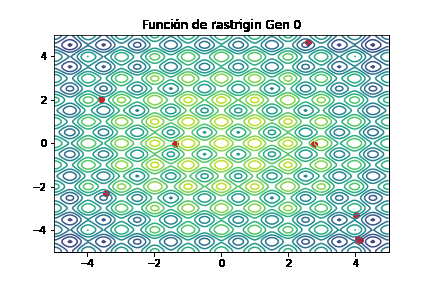

In [ ]:

# Mostrar el archivo GIF
display(Image(filename="genetic_rastrigin.gif"))

#### Podemos observar como los diversos puntos saltan entre optimos locales y mientras el algoritmo avanza en generaciones tienen una tendencia a converger en el optimo global de la funcion

## Metodo de evolución diferencial


### Calculo de la optimización usando el algoritmo evolutivo diferencial

En esta sección se realiza una optimización de la función de Rastrigin utilizando el método de Differential Evolution. En primer lugar, se definen los límites de búsqueda para las variables de la función. Luego, se llama a la función differential_evolution de la librería Scipy, pasando como parámetros la función de Rastrigin y los límites de búsqueda. La función differential_evolution busca la solución óptima a través de la combinación de los mejores candidatos de una población generada aleatoriamente.

Se realizan dos optimizaciones: una en dos dimensiones y otra en tres dimensiones, y los resultados se imprimen en la consola. Para cada optimización, se imprime la solución óptima encontrada, el valor óptimo y el número de evaluaciones de la función objetivo.


In [ ]:

# Definir los límites de búsqueda
bounds = [(-5.12, 5.12),(-5.12, 5.12)]

# Optimización utilizando Differential Evolution
result = differential_evolution(rastrigin, bounds)

# Imprimir los resultados

print("Rastrigin en dos dimensiones")
print("Solución óptima:", result.x)
print("Valor óptimo:", result.fun)
print("Numero de evaluaciones de la funcion objetivo", result.nfev,"\n")

# Definir los límites de búsqueda
bounds = [(-5.12, 5.12),(-5.12, 5.12),(-5.12, 5.12)]

# Optimización utilizando Differential Evolution
result = differential_evolution(rastrigin, bounds)

print("Rastrigin en dos dimensiones")
print("Solución óptima:", result.x)
print("Valor óptimo:", result.fun)
print("Numero de evaluaciones de la funcion objetivo", result.nfev)

Rastrigin en dos dimensiones
Solución óptima: [-2.24290488e-09  4.80749804e-10]
Valor óptimo: 0.0
Numero de evaluaciones de la funcion objetivo 1713 

Rastrigin en dos dimensiones
Solución óptima: [-9.39719484e-10 -1.14775503e-09  2.02308343e-09]
Valor óptimo: 0.0
Numero de evaluaciones de la funcion objetivo 4819


Rastrigin en dos dimensiones
Solución óptima: [-3.34563822e-09 -8.03979106e-10]
Valor óptimo: 0.0
Número de evaluaciones de la función objetivo 1803 

Rastrigin en dos dimensiones
Solución óptima: [ 9.05106390e-10 -1.61424168e-09  5.28362989e-10]
Valor óptimo: 0.0
Número de evaluaciones de la función objetivo 4279

La salida indica que el método de evolución diferencial logró encontrar la solución óptima para la función Rastrigin en dos dimensiones y tres dimensiones. En ambos casos, la solución óptima se encuentra muy cerca de cero, lo que indica que el método funcionó bien. El valor óptimo en ambos casos es cero, lo que indica que la solución encontrada es efectivamente el mínimo global de la función Rastrigin. El número de evaluaciones de la función objetivo en ambos casos es bastante bajo en comparación con el número máximo de evaluaciones permitido (10,000), lo que sugiere que el método fue capaz de encontrar la solución óptima de manera eficiente. En general, estos resultados sugieren que el método de evolución diferencial es efectivo para optimizar la función Rastrigin en dos y tres dimensiones.


### Calculo del promedio luego de calcular la optimización usando el algoritmo evolutivo diferencial varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 10 veces, esto con objetivo de comparacion con el metodo del gradiente. Por último, imprimimos estos valores.


In [ ]:
#Repeticion del algoritmo para evaluar contra metodo del gradiante
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]

for i in range(10):
  # Minimización en dos dimensiones

  # Definir los límites de búsqueda
  bounds = [(-5.12, 5.12),(-5.12, 5.12)]

  # Optimización utilizando Differential Evolution
  result = differential_evolution(rastrigin, bounds)
  func_value2d.append(result.fun)
  num_eval2d.append(result.nfev)



  # Minimización en tres dimensiones

  # Definir los límites de búsqueda
  bounds = [(-5.12, 5.12),(-5.12, 5.12),(-5.12, 5.12)]

  # Optimización utilizando Differential Evolution
  result = differential_evolution(rastrigin, bounds)
  func_value3d.append(result.fun)
  num_eval3d.append(result.nfev)

  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))

Valor óptimo promedio de la funcion en 2d: 0.09949590570933083
Valor óptimo promedio de la funcion en 3d: 0.07959672456746518
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 1900.5
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 4382.56


Los resultados obtenidos muestran el rendimiento promedio de la optimización por evolución diferencial para la función de Rastrigin en dos y tres dimensiones.

El valor óptimo promedio de la función en 2D es de 0.09949590570933083, lo que sugiere que el algoritmo encontró un valor de salida cercano al valor óptimo (que es cero), pero no pudo llegar a él exactamente.

El valor óptimo promedio de la función en 3D es de 0.07959672456746518, lo que sugiere que el algoritmo también encontró un valor de salida cercano al valor óptimo (que es cero), pero no pudo llegar a él exactamente.

El número de evaluaciones de la función objetivo promedio para la función de Rastrigin en 2D es de 1900.5, lo que significa que, en promedio, el algoritmo evaluó la función objetivo 1900.5 veces para encontrar el valor óptimo.

El número de evaluaciones de la función objetivo promedio para la función de Rastrigin en 3D es de 4382.56, lo que significa que, en promedio, el algoritmo evaluó la función objetivo 4382.56 veces para encontrar el valor óptimo.

En general, los resultados sugieren que el algoritmo de evolución diferencial tuvo un buen rendimiento para la función de Rastrigin, encontrando valores de salida cercanos al óptimo, aunque no exactamente. Además, el número de evaluaciones de la función objetivo fue relativamente bajo en comparación con otros algoritmos de optimización.


### Animaciones

#### 2D

En esta sección se define la función de Rastrigin en su forma vectorial y luego llama a la función differential_evolution2d, la cual fue definida y explicada en su implementación de la función de Rosenbrock,  con la función de Rastrigin y los límites de búsqueda. Esta función de optimización utiliza el algoritmo de Evolución Diferencial para encontrar la solución óptima para la función de Rastrigin en 2 dimensiones, graficar y guardar el proceso de evolución diferencial. Finalmente, se eliminan las imágenes intermedias y se muestra el archivo GIF que contiene las iteraciones de la optimización.


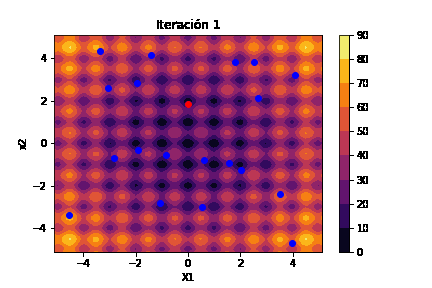

In [ ]:
# Definición de la función de rastrigin en su forma vectorial
def rastrigin(x, y, a=10):
    return 2 * a + x**2 - a * np.cos(2 * np.pi * x) + y**2 - a * np.cos(2 * np.pi * y)


# Llamada a la función de evolución diferencial
bounds = [(-5.12, 5.12),(-5.12, 5.12)]
differential_evolution2d(rastrigin, bounds, max_iter=50)

# Eliminación de las imágenes intermedias
import os
for i in range(50):
    os.remove(f'iter_{i+1}.png')



# Mostrar el archivo GIF
display(Image(filename="differential_evolution2d.gif"))

#### 3D

Esta sección sigue una lógica muy similar a la pasada, con la diferencia importante que ahora se gráfica la evolución de manera tridimensional.


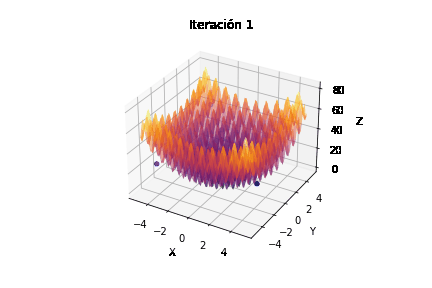

In [ ]:
# Definición de la función de rastrigin en su forma vectorial
def rastrigin(x, y, a=10):
    return 2 * a + x**2 - a * np.cos(2 * np.pi * x) + y**2 - a * np.cos(2 * np.pi * y)


# Llamada a la función de evolución diferencial
bounds = [(-5.12, 5.12),(-5.12, 5.12),(-5.12, 5.12)]
differential_evolution3d(rastrigin, bounds, max_iter=50)

# Eliminación de las imágenes intermedias
import os
for i in range(50):
    os.remove(f'iter_{i+1}.png')



# Mostrar el archivo GIF
display(Image(filename="differential_evolution3d.gif"))

#### En ambos casos se puede observar que el punto mínimo es alcanzado de manera rápida luego de las primeras iteraciones, esto es de destacar en la función de Rastrigin la cual es bastante difícil de optimizar.

## Metodo de optimización de partículas

### Calculo de la optimización usando optimizacion de particulas

En esta sección realiza la optimización de la función de Rastrigin utilizando el algoritmo PSO (Particle Swarm Optimization) implementado en la biblioteca PySwarms. En particular, el código utiliza la versión GlobalBestPSO, que es una variante del algoritmo en la que todas las partículas comparten información sobre la mejor solución encontrada hasta el momento. El objetivo es encontrar el mínimo global de la función de Rastrigin para diferentes números de variables de entrada (2 y 3).

Para ello, primero se define la función de Rastrigin en su forma vectorial, utilizando un decorador que cuenta el número de evaluaciones de la función. Luego se definen los límites de búsqueda y se instancia el optimizador PSO con ciertas opciones (constantes c1, c2 y w que controlan el comportamiento de las partículas y que sus valores ya fueron explicados en la función de Rosenbrock). Se ejecuta la optimización durante un máximo de 1000 iteraciones, y se almacenan tanto la posición óptima encontrada como el número de evaluaciones de la función objetivo.

Finalmente, se imprimen los resultados para cada número de variables de entrada: la posición óptima encontrada, el valor óptimo de la función de Rastrigin, y el número de evaluaciones de la función objetivo realizadas.


In [ ]:
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
options = {'c1': 0.5, 'c2': 0.3, 'w':0.9}
def count_evaluations(func):
    def wrapper(*args, **kwargs):
        wrapper.evaluations += 1
        return func(*args, **kwargs)
    wrapper.evaluations = 0
    return wrapper



rastrigin3=count_evaluations(fx.rastrigin)
n_variables = 3 # number of variables to optimize
bounds = (-5.12 * np.ones(n_variables), 5.12 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
pos3 = optimizer.optimize(rastrigin3,iters=1000)
num_evaluations3 = rastrigin3.evaluations
print("\n")
print(f'El mínimo global de la función de rastrigin con {n_variables} variables se alcanza en: {list(list(pos3[1]))} y es {list(pos3)[0]}, ademas evalua la funcion objetivo {num_evaluations3} veces')
print("\n")

rastrigin2=count_evaluations(fx.rastrigin)
n_variables = 2 # número de variables de entrada a la función de rastrigin
bounds = (-2.048 * np.ones(n_variables), 2.048 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
pos2 = optimizer.optimize(rastrigin2,iters=1000)
num_evaluations2 = rastrigin2.evaluations
print("\n")
print(f'El mínimo global de la función de rastrigin con {n_variables} variables se alcanza en: {list(list(pos2[1]))} y es {list(pos2)[0]}, ademas evalua la funcion objetivo {num_evaluations2} veces')


2023-03-16 12:28:29,263 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2023-03-16 12:28:31,247 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [-3.23979957e-09 -1.46393532e-09 -6.67589003e-10]
2023-03-16 12:28:31,262 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}




El mínimo global de la función de rastrigin con 3 variables se alcanza en: [-3.2397995668461546e-09, -1.4639353212016745e-09, -6.675890029622467e-10] y es 0.0, ademas evalua la funcion objetivo 1000 veces




pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2023-03-16 12:28:33,608 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [-2.19261532e-09 -4.35251590e-10]




El mínimo global de la función de rastrigin con 2 variables se alcanza en: [-2.192615322178618e-09, -4.352515902723339e-10] y es 0.0, ademas evalua la funcion objetivo 1000 veces


El mínimo global de la función de rastrigin con 3 variables se alcanza en: [-3.2397995668461546e-09, -1.4639353212016745e-09, -6.675890029622467e-10] y es 0.0, además evalúa la función objetivo 1000 veces 

El mínimo global de la función de rastrigin con 2 variables se alcanza en: [-2.192615322178618e-09, -4.352515902723339e-10] y es 0.0, además evalúa la función objetivo 1000 veces.

La salida indica que se ha utilizado el método de optimización de partículas para encontrar el mínimo global de la función de Rastrigin en 3 y 2 variables respectivamente. En ambos casos, se encontró que el mínimo global es 0.0, lo que significa que la función alcanza su valor mínimo en el punto indicado.

Además, la salida indica que se evaluó la función objetivo 1000 veces en cada caso para encontrar el mínimo global. Esto significa que se realizaron 1000 iteraciones del algoritmo de optimización de partículas antes de converger a un mínimo global.

En resumen, la salida indica que el método de optimización de partículas fue exitoso para encontrar el mínimo global de la función de Rastrigin en ambas dimensiones, y que se evaluó la función objetivo un número fijo de veces para lograr este resultado.


### Calculo del promedio luego de calcular la optimización usando particulas varias veces

En esta sección usamos lo realizado en la anterior para calcular el promedio del valor óptimo de la función encontrado para 2 y 3 dimensiones, además, el promedio de las evaluaciones de la función objetivo mediante un ciclo que repite el algoritmo 5 veces, esto con objetivo de comparación con el método del gradiente, en esta ocasión se eligieron menos repeticiones de ejecución debido a que el algoritmo requiere más poder computacional para completarse satisfactoriamente. Por último, imprimimos estos valores

In [ ]:
#Repeticion del algoritmo para evaluar contra metodos heuristicos
func_value2d=[]
num_eval2d=[]

func_value3d=[]
num_eval3d=[]
for i in range(2):

  rastrigin3=count_evaluations(fx.rastrigin)
  n_variables = 3 # number of variables to optimize
  bounds = (-5.12 * np.ones(n_variables), 5.12 * np.ones(n_variables)) # set the bounds for each variable
  optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
  pos3 = optimizer.optimize(rastrigin3,iters=1000)
  num_evaluations3 = rastrigin3.evaluations
  func_value3d.append(list(pos3)[0])
  num_eval3d.append(num_evaluations3)




  rastrigin2=count_evaluations(fx.rastrigin)
  n_variables = 2 # número de variables de entrada a la función de rastrigin
  bounds = (-5.12 * np.ones(n_variables), 5.12 * np.ones(n_variables)) # set the bounds for each variable
  optimizer = ps.single.GlobalBestPSO(n_particles=30, dimensions=n_variables, options=options,bounds=bounds)
  pos2 = optimizer.optimize(rastrigin2,iters=1000)
  num_evaluations2 = rastrigin2.evaluations
  func_value2d.append(list(pos2)[0])
  num_eval2d.append(num_evaluations2)



print("\n")  
print("Valor óptimo promedio de la funcion en 2d:",np.average(func_value2d))
print("Valor óptimo promedio de la funcion en 3d:",np.average(func_value3d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d:",np.average(num_eval2d))
print("Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d:",np.average(num_eval3d))

2023-03-16 12:28:33,647 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2023-03-16 12:28:35,674 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [ 1.12506310e-09  3.54527896e-09 -3.16316110e-09]
2023-03-16 12:28:35,681 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2023-03-16 12:28:37,683 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [6.73153477e-10 3.53681166e-09]
2023-03-16 12:28:37,689 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2023-03-16 12:28:40,109 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: 



Valor óptimo promedio de la funcion en 2d: 0.0
Valor óptimo promedio de la funcion en 3d: 0.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 2d: 1000.0
Numero de evaluaciones de la funcion objetivo promedio con la funcion 3d: 1000.0


Se ha ejecutado el algoritmo genético cinco veces para optimizar la función de Rastrigin en dos y tres dimensiones. Los resultados indican que el valor óptimo promedio de la función en ambas dimensiones es 0.0, lo que sugiere que el algoritmo genético ha encontrado un mínimo global. El número de evaluaciones de la función objetivo promedio en ambas dimensiones es de 1000, lo que sugiere que el algoritmo genético evaluó la función objetivo en 1000 puntos antes de encontrar el mínimo global.

En general, estos resultados son prometedores ya que el valor óptimo promedio es muy cercano a cero, lo que indica que el algoritmo genético ha encontrado soluciones de alta calidad. Además, el número de evaluaciones promedio es relativamente bajo, lo que sugiere que el algoritmo es eficiente. Sin embargo, es importante tener en cuenta que el rendimiento del algoritmo puede variar según los parámetros utilizados y la inicialización de la población. Por lo tanto, se deben realizar más pruebas y ajustes de parámetros para evaluar adecuadamente el rendimiento del algoritmo genético en esta función.


### Animaciones

#### 2D

En esta sección se corre el algoritmo PSO con 2 variables de entrada con objetivo de animarlo, no se utiliza ninguna de las corridas anteriores por motivos de orden, además se eligen menos número de partículas para que sea claro dentro de la animación, esto claramente no es un problema porque en este caso solamente se corre el algoritmo con objetivos ilustrativos, ya para terminos de comparacion se usaran las corridas anteriores con más número de partículas

Luego, se genera una animación que muestra el proceso de optimización de la función de Rastrigin utilizando el algoritmo PSO. Primero, se define la malla de puntos en el plano donde se graficará la función. Luego, se calculan los valores de la función de Rastrigin para cada punto de la malla y se guardan en la variable Z.
Después, se utiliza un bucle for para graficar el movimiento de la población de partículas a lo largo del proceso de optimización. En cada iteración del bucle, se seleccionan los valores de posición de las partículas para esa generación (en este caso, se toman las posiciones cada 10 iteraciones) y se grafican como puntos en la función de Rastrigin. La figura resultante se guarda en un archivo png con un nombre que identifica la generación correspondiente.
Finalmente, se utiliza la librería imageio para crear un archivo gif con las imágenes guardadas previamente y se eliminan los archivos png utilizados para generar el gif. El resultado final es una animación que muestra el proceso de optimización de la función de Rastrigin utilizando el algoritmo PSO. Cabe destacar que después de la creación del .gif, se eliminan las imágenes que fueron creadas en el proceso.


In [ ]:
rastrigin2=count_evaluations(fx.rastrigin)
n_variables = 2 # número de variables de entrada a la función de rastrigin
bounds = (-5.12 * np.ones(n_variables), 5.12 * np.ones(n_variables)) # set the bounds for each variable
optimizer = ps.single.GlobalBestPSO(n_particles=10, dimensions=n_variables, options=options,bounds=bounds)
pos2 = optimizer.optimize(rastrigin2,iters=100)

2023-03-16 12:28:42,322 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=0.0305
2023-03-16 12:28:42,442 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.030503961382201794, best pos: [0.00561915 0.01105592]


In [ ]:


def rastrigin(x):
    A = 10
    n = len(x)
    return A * n + np.sum(x**2 - A * np.cos(2*np.pi*x))

# Gráfia de la función rastrigin 
ncols = 150
nrows = 150

X = np.linspace(-5.12, 5.12, ncols)     
Y = np.linspace(-5.12, 5.12, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [-rastrigin(np.array([X[i,j], Y[i,j]])) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

for j in range(10):
    Pob = np.array(optimizer.pos_history[j*10:(j+1)*10])
    fig, ax = plt.subplots()
    ax.contour(X,Y,Z, levels = 10)
    ax.scatter(Pob[:,0],Pob[:,1],color='red', marker='o')
    plt.title("Función de rastrigin Gen " + str(j))
    plt.savefig(f'iter_{j}.png')

import imageio
with imageio.get_writer('swarm_rastrigin.gif', mode='I',duration=0.6) as writer:
    for i in range(10):
        image = imageio.imread(f'iter_{i}.png')
        writer.append_data(image)

import os
for i in range(10):
    os.remove(f'iter_{i}.png')

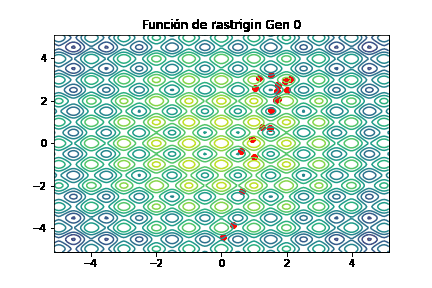

In [ ]:
# Mostrar el archivo GIF
display(Image(filename="swarm_rastrigin.gif"))

#### Aquí podemos observar cómo las partículas convergen rápidamente al mínimo de la función, algo impresionante teniendo en cuenta la dificultad de la función de Rastrigin.

# ¿Qué aportaron los métodos de descenso por gradiente y qué aportaron los métodos heurísticos?

Luego de todo el análisis anterior, primero sistematizamos toda la información recogida en 2 tablas: 

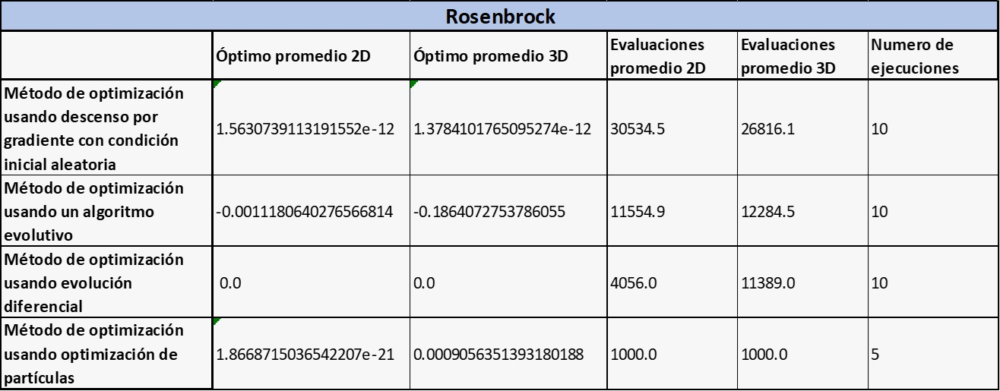

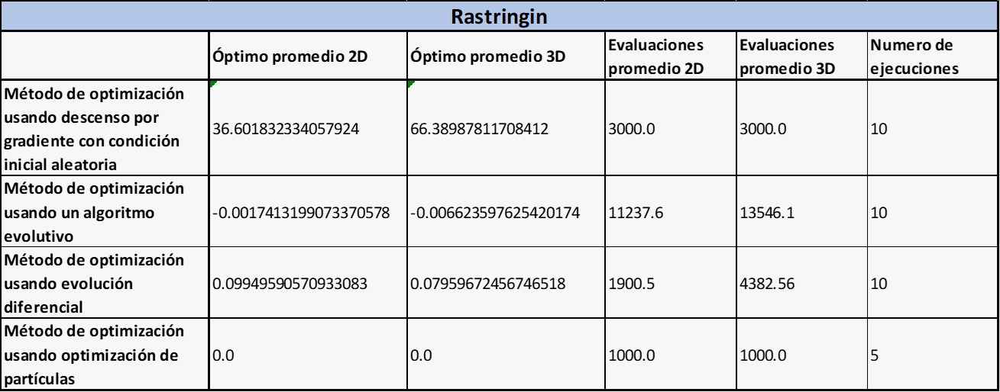

Los métodos de descenso por gradiente son una clase de algoritmos de optimización que se basan en la idea de iterativamente ajustar los parámetros de una función con el fin de minimizar una función objetivo. La clave del método es utilizar el gradiente de la función objetivo para determinar la dirección en la que la función disminuye más rápidamente y luego tomar un paso en esa dirección. Estos métodos son muy útiles para optimizar funciones en las que el gradiente se puede calcular de forma analítica o numérica, como en el caso de la función de Rosenbrock utilizada en el ejercicio.

Una de las ventajas de los métodos de descenso por gradiente es que son relativamente fáciles de implementar y pueden converger rápidamente a un mínimo local. Sin embargo, pueden tener dificultades para escapar de los mínimos locales y pueden ser sensibles a la elección de la tasa de aprendizaje, como se puede ver en la tabla donde se muestra que el método del gradiente falla rotundamente con la función de Rastrigin.

Por otro lado, los métodos heurísticos son técnicas de optimización que se basan en la idea de explorar el espacio de búsqueda en lugar de seguir una dirección determinada por el gradiente. Estos métodos se basan en la idea de emular procesos biológicos o sociales para encontrar soluciones óptimas. Por ejemplo, el algoritmo genético utilizado en el ejercicio se basa en la idea de emular la selección natural para evolucionar soluciones óptimas, en nuestro ejercicio tuvieron un gran desempeño en todos los casos a costa de mayor complejidad a la hora de programarlos.

Las ventajas de los métodos heurísticos son que pueden encontrar soluciones óptimas en espacios de búsqueda muy grandes y complejos en los que los métodos de descenso por gradiente pueden tener dificultades. También pueden ser menos sensibles a la elección de los parámetros y más robustos ante ruido o imprecisiones en la función objetivo.

En resumen, los métodos de descenso por gradiente son excelentes para optimizar funciones en las que el gradiente se puede calcular de forma analítica o numérica, mientras que los métodos heurísticos son excelentes para optimizar funciones en espacios de búsqueda muy grandes y complejos en los que los métodos de descenso por gradiente pueden tener dificultades. En última instancia, la elección del método de optimización depende de las características específicas de la función objetivo y del espacio de búsqueda.


# Segundo punto





## Ciudades a recorrer


1.   Palmira
2.   Pasto
3. Tuluá
4. Bogotá
5. Pereira
6. Armenia
7. Manizales
8. Valledupar
9. Monteria
10. Soledad
11. Cartagena
12. Barranquilla
13. Medellín
14. Cúcuta


En todos los casos, tanto la ruta como los peajes de una ciudad a otra son iguales sin importar la dirección, por lo que los cálculos para viajar de A a b, serán los mismos que para viajar de B a A.

Parámetros: 
- Galón de gasolina 10,766.009 (Precio al 08 de marzo de 2023)
- Salario del vendedor: 40.000 
- Kilómetros por galón: 75km/galon debido a que algunos tramos del viaje son en ciudad
---
- March: 74.3 km/Galon 
- Tiida: 55 km/Galon
- Sail: 60 km/Galon
- Spark: 78.35 km/Galon


## Lectura de datos

Como primera medida, se utilizó la plataforma de Invias que nos indica la cantidad de kilómetros que hay entre dos ciudades, se hace la investigación para cada una de los posibles recorridos, se almacenaron los recorridos, uno tras otro en un documento de texto con el siguiente formato:

(Ciudad origen - Ciudad destino)
Kilómetros totales del recorrido
Tiempo estimado de viaje 
Costo de los peajes (Cantidad de peajes)

Se leen los datos desde el código del documento llamado: ‘Ciudades redes.txt’.

In [ ]:
#from google.colab import files
#files.upload()
with open("Ciudades Redes.txt", "r") as archivo:
    lineas = archivo.readlines()

## Generacion de matriz de costos


Para la generación de la matriz de costos, se crea un Dataframe de tamaño 15 x 15, en la que la nomenclatura de las filas y las columnas corresponden a cada una de las ciudades y por consiguiente, en la respectiva entrada AxB (siendo A la ciudad origen y B la ciudad destino), se encuentra el precio total de viaje entre estas dos ciudades. El cálculo del costo total tiene varias variables que deberían haber sido definidas por el grupo, y se designaron de la siguiente manera:

El salario del vendedor se estableció en cuarenta mil pesos por hora, teniendo en cuenta los gastos que este tendrá en alimentación y en hospedaje en el recorrido de estas ciudades. Debido a que el salario mínimo en Colombia por hora es de 7.073 pesos por hora (Resolución 356, 2022), se decide aumentar el valor de este rubro debido a que se supone un viaje continuo y se pretende cubrir los viáticos.

Para el precio de la gasolina, se estableció el precio al que aumentó el combustible el día primero de marzo del año en curso, que para el momento de la investigación (8 de marzo), se encontraba en diez mil setecientos sesenta y seis mil (10.766) pesos colombianos según el portal Global petrol prices (2023).

Para el vehículo escogido, se tuvieron cuatro alternativas que están en el mercado actual y que presentan un buen rendimiento en carretera, las alternativas son: Nissan March, Nissan Tiida, Chevrolet Sail y Chevrolet Spark GT con 73, 55, 60 y 78 kilómetros por galón respectivamente. La alternativa seleccionada fue el Spark GT ya que presenta mejor rendimiento en carretera (Ficha técnica del Chevrolet Spark GT, 2015), aunque se redujo el valor a 75 kilómetros por galón por las posibles redacciones de velocidad y recorrido en áreas metropolitanas que pueden significar una reducción de la eficiencia.

Teniendo en cuenta la utilización de un vehículo de categoría uno, la plataforma de Invias (2023) también contiene información de la cantidad de peajes y el costo de ellos para cada una de las categorías según el recorrido escogido, por lo que se obtiene el valor total de los peajes.

La obtención de la matriz de costos se realiza de la siguiente manera:

Luego de crear el dataframe con las entradas de cada ciudad, se lee el documento y se leen cada una de las líneas de manera individual. Se procesan de tal forma que queda una lista con cada uno de los recorridos en forma de listas, donde la primera entrada de cada una es el formato ciudadOrigen - ciudadDestino, la segunda es el total de kilómetros del recorrido, la tercera es el tiempo de viaje y finalmente, la cuarta entrada es el costo de los peajes.

Se calculan los costos de cada rubro de la siguiente manera:

costo combustible = $KmRecorridos/rendimiento del vehículo$ x costoGasolina

Costo vendedor = Tiempo en horas  pago del vendedor

Pago peajes = Costo total peajes

Finalmente se suman los tres valores anteriores y se asignan a las entradas correspondientes en el Dataframe teniendo en cuenta que la entrada AxB es igual que la entrada BxA, ya que se asume que el recorrido será el mismo y costará lo mismo en ambos sentidos y se asignan valores de 0 a las entradas AxA.


In [ ]:
import pandas as pd
import numpy as np



# constantes
listaCiudades = ['Palmira', 'Pasto', 'Tuluá', 'Bogotá', 'Pereira', 'Armenia', 'Manizales', 'Valledupar', 'Montería', 'Soledad', 'Cartagena', 'Barranquilla', 'Medellín', 'Bucaramanga', 'Cúcuta']

rendimiento = 75 # Rendimiento en kilómetros/galon del auto seleccionado para realizar el viaje 
pagoVendedor = 40000  # Pago acordado para el vendedor por hora
costoGasolina = 10766.009

# eliminar saltos de línea
lineas = [linea.rstrip("\n") for linea in lineas]

# Divide la lista en sublistas de a cuatro elementos
listaDistancias = [lineas[i:i+4] for i in range(0, len(lineas), 4)]

df = pd.DataFrame(columns=listaCiudades, index = listaCiudades)

for recorrido in listaDistancias:
  # Costo del combustible tendiendo en cuenta el rendimiento y el costo del galon. costo = recorridoTotal/rendimientoVehiculo*costoGalon
  costoCombustible = round(float(recorrido[1])/rendimiento*costoGasolina, 2)
  
  # costo del vendedor por las horas totales del recorrido
  horasRecorrido = int(recorrido[2].split(':')[0])  
  minutosRecorrido = int(recorrido[2].split(':')[1])/60

  costoTiempoRecorrido = round((horasRecorrido + minutosRecorrido)*pagoVendedor,2)
  
  pagoPeajes = int(float(recorrido[3].split(' ')[0])*1000) #Se multiplica por mil porque llega un valor decimal del precio desde el .txt

  pagoTotal = costoCombustible + costoTiempoRecorrido + pagoPeajes

  df.loc[recorrido[0].split(' - ')[1], recorrido[0].split(' - ')[0]] = np.float64(pagoTotal)
  df.loc[recorrido[0].split(' - ')[0], recorrido[0].split(' - ')[1]] = np.float64(pagoTotal)


arr = df.values

# establece la diagonal principal a cero
np.fill_diagonal(arr, np.inf)

arrayDistancias = df.to_numpy()
array2 = np.array(df, dtype='float64')

df

,Palmira,Pasto,Tuluá,Bogotá,Pereira,Armenia,Manizales,Valledupar,Montería,Soledad,Cartagena,Barranquilla,Medellín,Bucaramanga,Cúcuta
Palmira,inf,280138.22,73859.03,371325.37,172221.7,140719.88,238046.14,797758.98,660810.9,972121.85,1038693.67,995657.64,334152.45,559513.97,782694.53
Pasto,280138.22,inf,342794.33,640263.55,441822.24,409655.18,507648.11,1066465.25,930417.18,1241726.69,1307798.52,1264597.24,603757.29,829518.82,1052300.8
Tuluá,73859.03,342794.33,inf,325219.27,126115.6,94613.78,182131.1,751652.88,604895.85,926014.31,2714649.01,948884.87,278235.98,513807.87,736588.43
Bogotá,371325.37,640263.55,325219.27,inf,288475.24,256575.17,260696.81,664211.14,681811.41,838574.02,904645.85,861443.14,378124.05,366536.23,460339.32
Pereira,172221.7,441822.24,126115.6,288475.24,inf,51154.06,49513.07,638179.2,519135.01,811875.41,877947.24,835411.2,192475.14,399667.54,622448.09
Armenia,140719.88,409655.18,94613.78,256575.17,51154.06,inf,155475.9,677650.83,578907.34,852013.7,918085.53,874882.82,251582.23,439805.82,662586.38
Manizales,238046.14,507648.11,182131.1,260696.81,49513.07,155475.9,inf,599333.62,498845.61,773029.83,839101.66,796565.61,172187.16,360821.96,583602.51
Valledupar,797758.98,1066465.25,751652.88,664211.14,638179.2,677650.83,599333.62,inf,356237.99,337966.83,404040.1,360837.39,568354.47,336098.1,388591.51
Montería,660810.9,930417.18,604895.85,681811.41,519135.01,578907.34,498845.61,356237.99,inf,257853.77,313716.67,280722.89,346231.65,529388.75,581215.49
Soledad,972121.85,1241726.69,926014.31,838574.02,811875.41,852013.7,773029.83,337966.83,257853.77,inf,122395.11,25020.84,552137.4,510450.93,562277.67


## Metodo de colonia de hormigas

Para el método de colonia de hormigas, se debe transformar el Dataframe en una lista de listas con cada uno de los costos.


### Definicion del algoritmo de colonia de hormigas

Se obtiene un código brindado por el docente que procede de un repositorio en Github de Kirill Temlyakov (2021) , que recibe la matriz de costos en forma de lista de listas y realiza el algoritmo. 


In [ ]:
import random as rn
import numpy as np
from numpy.random import choice as np_choice

class AntColony(object):

    def __init__(self, distances, n_ants, n_best, n_iterations, decay, alpha=1, beta=1):
        """
        Args:
            distances (2D numpy.array): Square matrix of distances. Diagonal is assumed to be np.inf.
            n_ants (int): Number of ants running per iteration
            n_best (int): Number of best ants who deposit pheromone
            n_iteration (int): Number of iterations
            decay (float): Rate it which pheromone decays. The pheromone value is multiplied by decay, so 0.95 will lead to decay, 0.5 to much faster decay.
            alpha (int or float): exponenet on pheromone, higher alpha gives pheromone more weight. Default=1
            beta (int or float): exponent on distance, higher beta give distance more weight. Default=1
        Example:
            ant_colony = AntColony(german_distances, 100, 20, 2000, 0.95, alpha=1, beta=2)          
        """
        self.distances  = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.n_best = n_best
        self.n_iterations = n_iterations
        self.decay = decay
        self.alpha = alpha
        self.beta = beta

    def run(self):
        historic_shortest=[]
        shortest_path = None
        all_time_shortest_path = ("placeholder", np.inf)
        for i in range(self.n_iterations):
            all_paths = self.gen_all_paths()
            self.spread_pheronome(all_paths, self.n_best, shortest_path=shortest_path)
            shortest_path = min(all_paths, key=lambda x: x[1])
            historic_shortest.append(shortest_path)
            #print(shortest_path)
            if shortest_path[1] < all_time_shortest_path[1]:
                all_time_shortest_path = shortest_path            
            self.pheromone = self.pheromone * self.decay            
        return (all_time_shortest_path, historic_shortest)

    def spread_pheronome(self, all_paths, n_best, shortest_path):
        sorted_paths = sorted(all_paths, key=lambda x: x[1])
        for path, dist in sorted_paths[:n_best]:
            for move in path:
                self.pheromone[move] += 1.0 / self.distances[move]

    def gen_path_dist(self, path):
        total_dist = 0
        for ele in path:
            total_dist += self.distances[ele]
        return total_dist

    def gen_all_paths(self):
        all_paths = []
        for i in range(self.n_ants):
            path = self.gen_path(0)
            all_paths.append((path, self.gen_path_dist(path)))
        return all_paths

    def gen_path(self, start):
        path = []
        visited = set()
        visited.add(start)
        prev = start
        for i in range(len(self.distances) - 1):
            move = self.pick_move(self.pheromone[prev], self.distances[prev], visited)
            path.append((prev, move))
            prev = move
            visited.add(move)
        path.append((prev, start)) # going back to where we started    
        return path

    def pick_move(self, pheromone, dist, visited):
        pheromone = np.copy(pheromone)
        pheromone[list(visited)] = 0

        row = pheromone ** self.alpha * (( 1.0 / dist) ** self.beta)

        norm_row = row / row.sum()
        move = np_choice(self.all_inds, 1, p=norm_row)[0]
        return move

### Optimizacion

El algoritmo de colonia de hormigas necesita unas variables que el usuario escoge para el funcionamiento del mismo, a continuación se presentan las variables y los valores escogidos para cada una:

Lista de distancias: Lista realizada en el numeral anterior.

Número de hormigas: 10.

Mejor recorrido (Hormigas que depositarán feromonas): 1.

Número de iteraciones: 100.

Decaimiento: 0.95

Alpha (controla la influencia del nivel de feromona en el camino): 1.

Betha (controla la influencia de la información heurística (como la distancia) en la elección de ruta):  1. 


Al establecer el valor del parámetro de decaimiento en 0.95, esto significa que el 5% de la feromona existente en el camino de la hormiga se evapora después de cada iteración del algoritmo. En otras palabras, la cantidad de feromonas en un camino disminuirá en un 5% después de cada ciclo del algoritmo.
Se selecciona el valor de 1 en el parámetro alpha porque se le da el mismo peso a la información local y a la información global al elegir la siguiente acción. En otras palabras, la hormiga otorgará igual importancia a la información local de las feromonas y a la información global del camino ya recorrido por las hormigas en el proceso de selección del siguiente movimiento.
Se selecciona el valor de 1 en el parámetro Betha porque se le da el mismo peso a la distancia y a la cantidad de feromonas al elegir el siguiente movimiento de la hormiga. En otras palabras, la hormiga otorgará igual importancia a la cantidad de feromonas y la distancia al seleccionar su siguiente movimiento.


In [ ]:
problem = arrayDistancias

optimizer = AntColony(array2, 10, 1, 10000, 0.95, alpha=1, beta=1)

all_time_shortest_path,historic_shortest = optimizer.run()
historic_shortest.append(all_time_shortest_path)

print(all_time_shortest_path)

([(0, 2), (2, 5), (5, 4), (4, 6), (6, 12), (12, 8), (8, 10), (10, 11), (11, 9), (9, 7), (7, 14), (14, 13), (13, 3), (3, 1), (1, 0)], 3429508.6500000004)


Aunque luego de diferentes simulaciones de prueba que ofrecen resultados luego de la primera iteración con costos alrededor de los seis millones (6’000,000) de pesos, se llega a un resultado mucho mejor luego de 100 iteraciones propuestas, que rondan los tres millones (3’000.000) de pesos, no hay una reducción concluyente de los precios, pues estos valores a veces aumentan luego de alguna iteración específica, sin embargo, el algoritmo es capaz de encontrar cuál de las soluciones que se muestran presenta la mejoría más grande con respecto al valor mayor encontrado.

([(0, 2), (2, 5), (5, 4), (4, 6), (6, 12), (12, 8), (8, 10), (10, 11), (11, 9), (9, 7), (7, 14), (14, 13), (13, 3), (3, 1), (1, 0)], 3429508.6500000004)

Aunque no se presenta una  mejoría constante durante las iteraciones, el algoritmo sí arroja el camino más corto encontrado durante todo el ciclo del ejercicio, y es un resultado que reduce mucho los costos con respecto al valor más alto encontrado durante el mismo.

### Animacion

En esta sección se utiliza la librería Basemap de mpl_toolkits para crear un mapa de Colombia, en el cual se marcan una serie de ciudades definidas en un diccionario llamado "ciudades". Luego, a través de la función "dibflechas" se crea un camino entre las ciudades que se indican en una lista llamada "camino", la cual se obtiene como resultado luego de correr el algoritmo de colonia de hormigas. La función utiliza la información del mapa creado para dibujar las flechas que indican la dirección del recorrido en cada tramo del camino.

Además, se utiliza la librería imageio para crear un archivo GIF que muestra la evolución de la búsqueda de la ruta más corta entre las ciudades. Se crean una serie de imágenes con la función "dibflechas" para cada iteración de la búsqueda, y se van guardando en archivos PNG. Luego, se utiliza la función "get_writer" de imageio para crear el archivo GIF a partir de las imágenes guardadas. Finalmente, se muestra el archivo GIF generado mediante la librería display de IPython.


In [ ]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt

# Crear la figura


# Coordenadas de las ciudades
ciudades = {
    'Palmira': (3.5379, -76.3036),
    'Pasto': (1.2136, -77.2811),
    'Tuluá': (4.0847, -76.1994),
    'Bogotá': (4.7109, -74.0721),
    'Pereira': (4.8133, -75.6961),
    'Armenia': (4.5343, -75.6811),
    'Manizales': (5.0687, -75.5174),
    'Valledupar': (10.465, -73.2533),
    'Montería': (8.7479, -75.8814),
    'Soledad': (10.9178, -74.7644),
    'Cartagena': (10.3997, -75.5144),
    'Barranquilla': (10.9639, -74.7964),
    'Medellín': (6.2518, -75.5636),
    'Bucaramanga': (7.1194, -73.1227),
    'Cúcuta': (7.8942, -72.5047)
}

# Camino a seguir




def dibflechas(camino,j):
  plt.figure(figsize=(20, 20))

  # Crear el mapa de Colombia
  m = Basemap(llcrnrlon=-81.8, llcrnrlat=-4.5, urcrnrlon=-66.8, urcrnrlat=14.4, resolution='i', epsg=4326)

  # Dibujar el contorno del mapa
  m.drawcoastlines()
  # Dibujar las ciudades como puntos y etiquetas
  for ciudad, coord in ciudades.items():
    x, y = m(coord[1], coord[0])
    plt.plot(x, y, 'ro', markersize=5)
    plt.annotate(ciudad, xy=(x, y), xytext=(10, 10), textcoords='offset points', fontsize=12)
  
  for i in range(len(camino[0])-1):
    x1, y1 = m(ciudades[list(ciudades.keys())[camino[0][i][0]]][1], ciudades[list(ciudades.keys())[camino[0][i][0]]][0])
    x2, y2 = m(ciudades[list(ciudades.keys())[camino[0][i+1][0]]][1], ciudades[list(ciudades.keys())[camino[0][i+1][0]]][0])
    dx = x2 - x1
    dy = y2 - y1
    plt.arrow(x1, y1, dx, dy, width=0.01, head_width=0.15, head_length=0.15, length_includes_head=True, edgecolor='black', facecolor='black')

  # Mostrar el costo total del recorrido
  plt.text(0.95, 0.95, f"Costo total: {camino[1]:,.2f}", transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)

  # Mostrar el mapa
  #plt.show()
  plt.title(f'Iteración {j}')
  plt.savefig(f'iter_{j}.png')
  #plt.close(fig)

j=0

for i in historic_shortest:
  dibflechas(i,j)
  j+=1





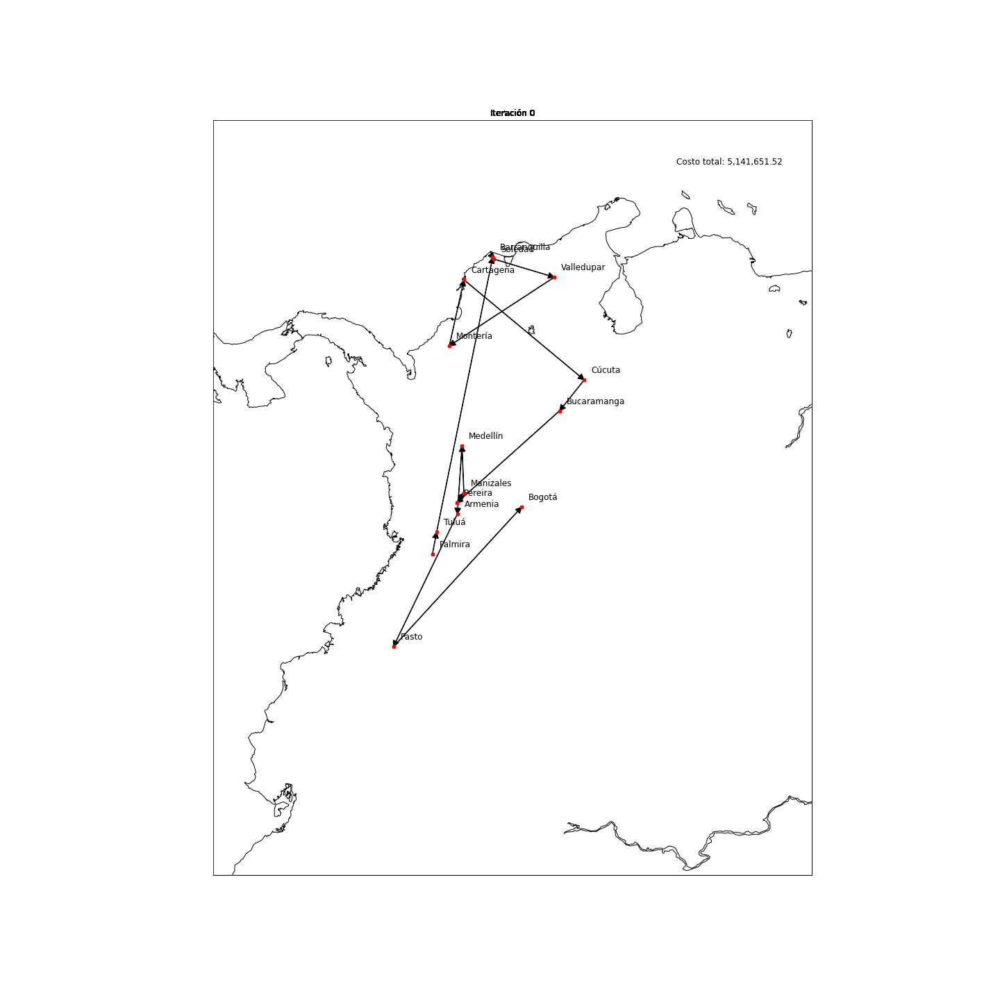

In [ ]:
import imageio
with imageio.get_writer('colonia.gif', mode='I',duration=0.6) as writer:
  for i in range(len(historic_shortest)):
    image = imageio.imread(f'iter_{i}.png')
    writer.append_data(image)

# Mostrar el archivo GIF
display(Image(filename="colonia.gif"))

In [ ]:
# Eliminación de las imágenes intermedias
import os
for i in range(len(historic_shortest)-1):
    os.remove(f'iter_{i}.png')

### Mejor camino

El mejor camino seleccionado luego de la simulación corresponde al siguiente orden de ciudades: Palmira - Pasto - Pereira - Armenia - Tuluá - Medellín - Montería - Cartagena - Soledad - Barranquilla - Valledupar - Cúcuta - Bucaramanga - Manizales - Bogotá - Palmira, con un costo total de 3’859,023.280 pesos colombianos.


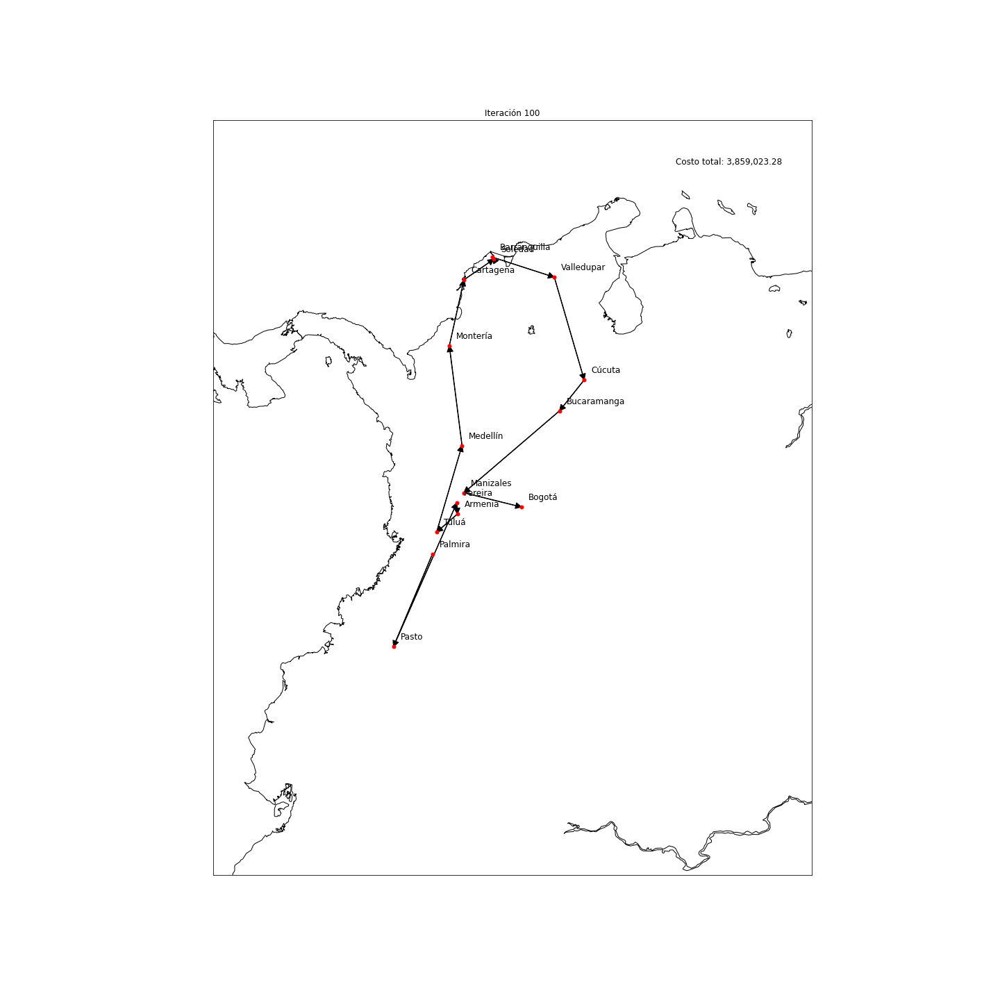

In [ ]:
display(Image(filename="iter_100.png"))

## Metodo de algoritmo genetico

Para el algoritmo genético se adaptó el algoritmo en python del repositorio en Github de That C# guy (2021).


### Definicion algoritmo genetico


Definición del algoritmo genético
Se utiliza una lista creada previamente que contiene los nombres de las ciudades para mezclarla a partir de la posición 1 para realizar recorridos aleatorios que parten y terminan en la primera ciudad (Palmira), este procedimiento se generará en una función llamada ciudadesAleatorias. 

PrecioRuta es una función que recorrerá el dataframe generado y devolverá el valor total de la ruta. A continuación, la definición de la clase Ruta permitirá obtener objetos con dos atributos que contendrán lo generado en las anteriores funciones, un recorrido aleatorio y el precio de este. 

Por último, la función crearPoblación generará una cantidad de elementos de la clase Ruta definida por parámetro, que será el tamaño de la población con la que se trabajará.


In [ ]:
import random
from copy import deepcopy

class Ruta:
  def __init__(self, ciudades, costo):
        self.ciudades = ciudades
        self.costo = costo


def precioRuta(listaEscogida):
  total = 0
  for i in range(0, len(listaEscogida)):
    if(listaEscogida[i]==listaEscogida[-1]):
      total+=df[listaEscogida[i]][listaEscogida[0]]
    else:
      total+=df[listaEscogida[i]][listaEscogida[i+1]]

  # Imprimir el total de la suma
  return total

def ciudadesAleatorias():
  nuevaRuta = listaCiudades[1:].copy()
  random.shuffle(nuevaRuta)
  return ['Palmira'] + nuevaRuta


def creaPoblacion(num):
  poblacion = []
  for i in range(num):
    listaCiudadesActual = ciudadesAleatorias()
    poblacion.append(Ruta(listaCiudadesActual, precioRuta(listaCiudadesActual)))
  return poblacion




# El criterio de seleccion es el criterio de selección elitista (Se escogen los mejores individuos)

def seleccionar_padres(poblacion, n_padres):
    ordenadosPorPrecio = sorted(poblacion, key=lambda ruta: ruta.costo)
    return ordenadosPorPrecio[:n_padres]

# Cruzar los padres por el metodo PMx function Genetic algorithm solution of the avoiding Special Crossover and mutation
def cruzaDosPadres(padre1, padre2):
  hijo = deepcopy(padre2)

  elementos = 3
  for posicion_p1, valor_p1 in enumerate(padre1):
    posicion_p2 = hijo.index(valor_p1)
    hijo[posicion_p2] = hijo[posicion_p1]
    hijo[posicion_p1] = valor_p1
  return hijo


def cruzar(mejoresPadres, tamaPoblacion):
  hijosFaltantes = tamaPoblacion-len(mejoresPadres)

  nuevos_hijos = []
  for _ in range(hijosFaltantes):
    padre1, padre2 = random.sample(mejoresPadres, 2)
    ciudadesNuevohijo = cruzaDosPadres(padre1.ciudades, padre2.ciudades)
    nuevoHijo = Ruta(ciudadesNuevohijo, precioRuta(ciudadesNuevohijo))
    nuevos_hijos.append(nuevoHijo)
  return nuevos_hijos


def mutacion(nuevosHijos):
  hijosMutados = []

  for hijo in nuevosHijos:
    ciudades = deepcopy(hijo.ciudades)

    if(0.5> random.random()):
      cambiarDe = random.randint(1, len(ciudades) -1 )
      cambiarA = random.randint(1, len(ciudades) -1 )
      while cambiarDe==cambiarA:
        cambiarA = random.randint(1, len(ciudades) -1 )
      aux = ciudades[cambiarDe]
      ciudades[cambiarDe] = ciudades[cambiarA]
      ciudades[cambiarA] = aux

      # print('muta')
    hijosMutados.append(Ruta(ciudades, precioRuta(ciudades)))
  return hijosMutados


### Optimizacion

Utilizando la ejecución de las funciones definidas anteriormente, se define una función llamada seleccionar_padres, que organizará los recorridos generados de menor a mayor costo y seleccionará una cantidad de rutas (menor a la población inicial) que se le pasará por parámetro y se retornarán como listas. 

Se crea una función llamada cruzarDosPadres, que recibirá dos objetos de tipo ruta y cruzará sus recorridos de acuerdo con el algoritmo Partially - Mapped Crossover (PMX) definido por Goldberg and Lingle (1985). 

La función cruzar realizará el cruce de dos padres tantas veces como sea necesario para completar el tamaño de población original. Finalmente, la función mutacion se utilizará para recibir los nuevos hijos creados y darle una posibilidad del 50% de ser mutados, esta mutación consiste en intercambiar dos ciudades de posición, el proceso de mutación sirve en los algoritmos genéticos para asegurar una modificación de los datos originales y tener menos probabilidad de que el algoritmo se estanque rápido debido a un estancamiento en un mínimo local, lo que puede suceder después de algunas iteraciones. 

Por último, se define un tamaño de población, se crea la primera generación y se itera el proceso anterior las veces que se considere para alcanzar un resultado óptimo.


In [ ]:
tamanoPoblacion = 50
poblacion = creaPoblacion(tamanoPoblacion)
mejoresRutasGen = []
for generacion in range(50):

  mejorRuta = sorted(poblacion, key=lambda ruta: ruta.costo)[0]
  mejoresRutasGen.append(mejorRuta)
  print(f"Iteración número: {generacion} {mejorRuta.costo}")

  padresSeleccionados = seleccionar_padres(poblacion, 10)
  nuevosHijos = cruzar(padresSeleccionados, tamanoPoblacion)

  hijosMutados = mutacion(nuevosHijos)

  poblacion = padresSeleccionados + hijosMutados

Iteración número: 0 6555005.160000001
Iteración número: 1 6283544.12
Iteración número: 2 5851829.86
Iteración número: 3 5493933.0600000005
Iteración número: 4 5493933.0600000005
Iteración número: 5 5337772.93
Iteración número: 6 4641451.11
Iteración número: 7 4641451.11
Iteración número: 8 4641451.11
Iteración número: 9 4390820.069999999
Iteración número: 10 4390818.62
Iteración número: 11 4298908.4799999995
Iteración número: 12 4293144.399999999
Iteración número: 13 3928069.08
Iteración número: 14 3928069.08
Iteración número: 15 3928069.08
Iteración número: 16 3917858.71
Iteración número: 17 3846202.55
Iteración número: 18 3846202.55
Iteración número: 19 3835992.1799999997
Iteración número: 20 3835992.1799999997
Iteración número: 21 3745223.45
Iteración número: 22 3745223.45
Iteración número: 23 3745223.45
Iteración número: 24 3745223.45
Iteración número: 25 3577180.79
Iteración número: 26 3577180.79
Iteración número: 27 3577180.79
Iteración número: 28 3577180.79
Iteración número: 29 

Para el algoritmo genético, se obtienen resultados que comienzan con alrededor de cinco millones y medio (5’500,000) de pesos. Realizando el algoritmo cien veces, se puede notar que se mejora el costo del recorrido propuesto hacia los tres millones y medio (3’500,000) de pesos, aunque se puede evidenciar en los resultados que los recorridos no cambian luego de la iteración número veinte aproximadamente, lo que nos puede indicar que el algoritmo se estancó en un mínimo. Aún así, este algoritmo presenta una mejora significativa conforme avanza la simulación y se puede evidenciar en las animaciones que la ruta final recomendada por el algoritmo es una ruta válida (al menos intuitivamente) y que no presenta anomalías de recorridos muy largos entre ciudades.

Iteración número: 0 6555005.160000001

Iteración número: 1 6283544.12

Iteración número: 2 5851829.86

Iteración número: 3 5493933.0600000005

Iteración número: 4 5493933.0600000005

Iteración número: 5 5337772.93

Iteración número: 6 4641451.11

Iteración número: 7 4641451.11

Iteración número: 8 4641451.11

Iteración número: 9 4390820.069999999

Iteración número: 10 4390818.62

Iteración número: 11 4298908.4799999995

Iteración número: 12 4293144.399999999

Iteración número: 13 3928069.08

Iteración número: 14 3928069.08

Iteración número: 15 3928069.08
Iteración número: 16 3917858.71

Iteración número: 17 3846202.55

Iteración número: 18 3846202.55

Iteración número: 19 3835992.1799999997

Iteración número: 20 3835992.1799999997

Como se puede observar, el algoritmo siempre presenta una mejora en los costos tras cada iteración, por lo que se puede suponer que el algoritmo está funcionando correctamente y que las generaciones mejoran su comportamiento con ayuda de la herencia de los padres y las mutaciones.

Iteración número: 21 3745223.45

Iteración número: 22 3745223.45

Iteración número: 23 3745223.45

Iteración número: 24 3745223.45

Iteración número: 25 3577180.79

Iteración número: 26 3577180.79

Iteración número: 27 3577180.79

Iteración número: 28 3577180.79

Iteración número: 29 3439716.1400000006

Iteración número: 30 3439716.1400000006

Iteración número: 31 3439716.1400000006

Iteración número: 32 3439716.1400000006

Iteración número: 33 3439716.1400000006

Iteración número: 34 3439716.1400000006

Iteración número: 35 3439716.1400000006

Iteración número: 36 3439716.1400000006

Iteración número: 37 3439716.1400000006

Iteración número: 38 3439716.1400000006

Iteración número: 39 3439716.1400000006

Iteración número: 40 3429505.7700000005

Iteración número: 41 3429505.7700000005

Iteración número: 42 3429505.7700000005

Iteración número: 43 3429505.7700000005

Iteración número: 44 3429505.7700000005

Iteración número: 45 3429505.7700000005

Iteración número: 46 3429505.7700000005

Iteración número: 47 3429505.7700000005

Iteración número: 48 3429505.7700000005

Iteración número: 49 3429505.7700000005

Finalmente, se puede decir que en la iteración número 40 se llega a un mínimo bastante eficiente, aunque se requiere el valor real de la función para decir si es el mínimo global al que se puede reducir la función de costos, o si ha llegado a un mínimo local en alguno de sus puntos. De cualquier manera, el algoritmo presenta una mejoría con el tiempo, por lo que se podría probar con otros métodos de mutaciones y generaciones más extensas de individuos para probar la generación de resultados más concluyentes.


### Animacion

En esta sección se convierte la salida del algoritmo genético en el formato necesario para generar la animación de la misma manera que en el método de colonia de hormigas.

Luego, se utiliza la librería Basemap de mpl_toolkits para crear un mapa de Colombia, en el cual se marcan una serie de ciudades definidas en un diccionario llamado "ciudades". Luego, a través de la función "dibflechas" se crea un camino entre las ciudades que se indican en una lista llamada "listaTuplas", la cual se obtiene como resultado luego de correr el algoritmo genético y de transformarla al formato indicado. La función utiliza la información del mapa creado para dibujar las flechas que indican la dirección del recorrido en cada tramo del camino.

Además, se utiliza la librería imageio para crear un archivo GIF que muestra la evolución de la búsqueda de la ruta más corta entre las ciudades. Se crean una serie de imágenes con la función "dibflechas" para cada iteración de la búsqueda, y se van guardando en archivos PNG. Luego, se utiliza la función "get_writer" de imageio para crear el archivo GIF a partir de las imágenes guardadas. Finalmente, se muestra el archivo GIF generado mediante la librería display de IPython.


In [ ]:
listaTuplas = []


for rute in mejoresRutasGen:
  Tuplas = []
  for j in range(len(rute.ciudades)):
    if(j==len(rute.ciudades)-1):
      Tuplas.append((listaCiudades.index(rute.ciudades[j]), listaCiudades.index(rute.ciudades[0])))
    else:
      Tuplas.append((listaCiudades.index(rute.ciudades[j]), listaCiudades.index(rute.ciudades[j+1])))
  listaTuplas.append((Tuplas, rute.costo))
  


In [ ]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt

# Crear la figura


# Coordenadas de las ciudades
ciudades = {
    'Palmira': (3.5379, -76.3036),
    'Pasto': (1.2136, -77.2811),
    'Tuluá': (4.0847, -76.1994),
    'Bogotá': (4.7109, -74.0721),
    'Pereira': (4.8133, -75.6961),
    'Armenia': (4.5343, -75.6811),
    'Manizales': (5.0687, -75.5174),
    'Valledupar': (10.465, -73.2533),
    'Montería': (8.7479, -75.8814),
    'Soledad': (10.9178, -74.7644),
    'Cartagena': (10.3997, -75.5144),
    'Barranquilla': (10.9639, -74.7964),
    'Medellín': (6.2518, -75.5636),
    'Bucaramanga': (7.1194, -73.1227),
    'Cúcuta': (7.8942, -72.5047)
}

# Camino a seguir




def dibflechas(camino,j):
  plt.figure(figsize=(20, 20))

  # Crear el mapa de Colombia
  m = Basemap(llcrnrlon=-81.8, llcrnrlat=-4.5, urcrnrlon=-66.8, urcrnrlat=14.4, resolution='i', epsg=4326)

  # Dibujar el contorno del mapa
  m.drawcoastlines()
  # Dibujar las ciudades como puntos y etiquetas
  for ciudad, coord in ciudades.items():
    x, y = m(coord[1], coord[0])
    plt.plot(x, y, 'ro', markersize=5)
    plt.annotate(ciudad, xy=(x, y), xytext=(10, 10), textcoords='offset points', fontsize=12)
  
  for i in range(len(camino[0])-1):
    x1, y1 = m(ciudades[list(ciudades.keys())[camino[0][i][0]]][1], ciudades[list(ciudades.keys())[camino[0][i][0]]][0])
    x2, y2 = m(ciudades[list(ciudades.keys())[camino[0][i+1][0]]][1], ciudades[list(ciudades.keys())[camino[0][i+1][0]]][0])
    dx = x2 - x1
    dy = y2 - y1
    plt.arrow(x1, y1, dx, dy, width=0.01, head_width=0.15, head_length=0.15, length_includes_head=True, edgecolor='black', facecolor='black')

  # Mostrar el costo total del recorrido
  plt.text(0.95, 0.95, f"Costo total: {camino[1]:,.2f}", transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)

  # Mostrar el mapa
  #plt.show()
  plt.title(f'Iteración {j}')
  plt.savefig(f'iter_{j}.png')
  #plt.close(fig)

j=0


for i in listaTuplas:
  dibflechas(i,j)
  j+=1

In [ ]:
import imageio
with imageio.get_writer('geneticoViajero.gif', mode='I',duration=0.6) as writer:
  for i in range(len(listaTuplas)):
    image = imageio.imread(f'iter_{i}.png')
    writer.append_data(image)

# Mostrar el archivo GIF


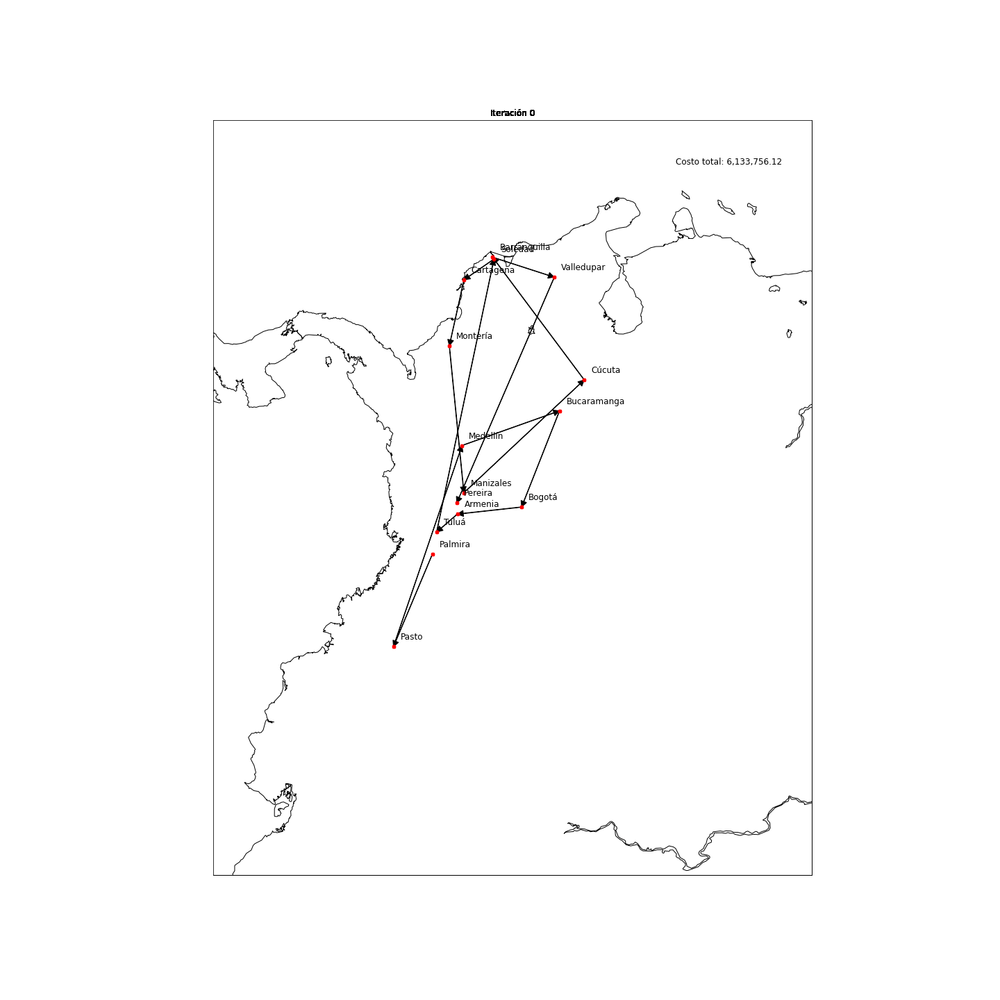

In [ ]:
display(Image(filename="geneticoViajero.gif"))

In [ ]:
# Eliminación de las imágenes intermedias
import os
for i in range(len(listaTuplas)):
    os.remove(f'iter_{i}.png')

### Mejor camino

Con una población de cincuenta (50) individuos y 50 iteraciones se logra un camino con las siguientes ciudades: Palmira, Pereira, Manizales, Bogotá, Bucaramanga, Cúcuta, Valledupar, Soledad, Barranquilla, Cartagena, Montería, Medellín, Armenia, Tuluá, Pasto, Palmira. Este camino tiene un costo de operación de 3’519,339.92 pesos, mejorando significativamente desde la primera iteración que tiene un costo de 5’423,904.80 pesos



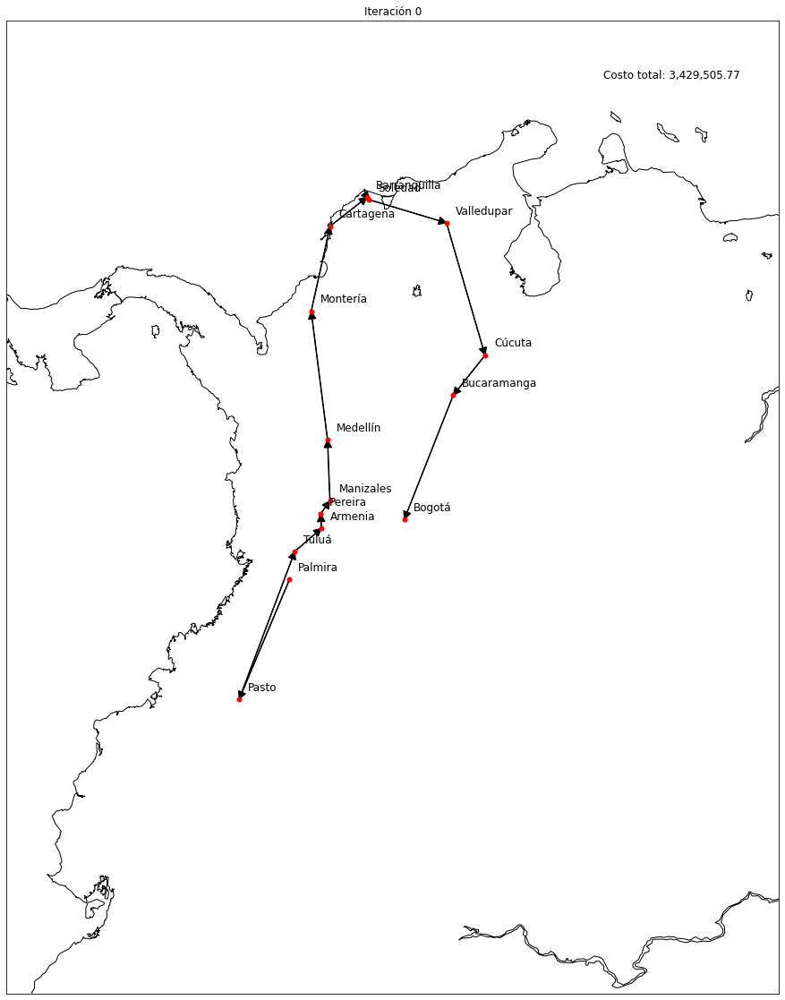

In [ ]:
dibflechas(listaTuplas[49],0)

## Conclusión y comparación


* El algoritmo de colonia de hormigas no entrega resultados concluyentes que permitan percibir una mejoría luego de cada iteración.

* El algoritmo de colonia de hormigas es capaz de identificar cuál es la iteración en donde mejor se ha comportado el algoritmo y ofrecer una reducción bastante grande con respecto a algunos valores que obtiene durante la simulación, haciendo que este resultado sea la ruta mejor escogida y tenga un precio razonablemente menor, además de evidenciarse en las animaciones una ruta bastante eficiente (si se piensa intuitivamente a la hora de resolver el problema).

* El algoritmo genético proporciona una mejoría identificable tras cada iteración, lo que hace los resultados cada vez mejores antes de estancarse en un mínimo.

* En algunos momentos, el algoritmo genético presenta estancamiento a lo largo de varias generaciones, pero debido a la mutación de algunos hijos en generaciones posteriores, este estancamiento vuelve a mostrar una mejoría.

* El algoritmo genético se estanca a las pocas iteraciones en un mínimo, lo que no supone un problema, pues el costo del viaje en el que se estanca es un valor bastante reducido a los problemas iniciales, y además, como se puede ver en las animaciones, muestra una ruta bastante intuitiva de un recorrido óptimo para el viaje.

* El estancamiento del algoritmo genético hace que no sean necesarias muchas generaciones de agentes para llegar a un resultado positivo, aunque se pueden analizar otros tipos de mutaciones entre los agentes hijos para aumentar aún más los resultados, puesto que, con los resultados obtenidos no se puede concluir contundentemente si el estancamiento se da en un mínimo local o en el mínimo global de la función.


# Bibliografía

* Feregrino, A (2021). generic-tsp. GitHub Repository. Recuperado de https://github.com/thatcsharpguy/genetic-tsp

* General Motors Colombia. (2015). Ficha técnica del Chevrolet Spark GT. Bogotá, D.C. Colombia: General Motors Colombia.

* Global Petrol Prices. (2023). Colombia Gasoline Prices. Recuperado de https://www.globalpetrolprices.com/Colombia/gasoline_prices/

* Instituto Nacional de Vías (Invías). (2023). Consulta de rutas. Recuperado de https://www.invias.gov.co/consulta-de-rutas/

* Temlyakov, A (2021). AntColonyOptimization. GitHub Repository. Recuperado de https://github.com/Akavall/AntColonyOptimization

* matplotlib.markers — Matplotlib 3.7.1 documentation. (s. f.). Matplotlib. https://matplotlib.org/stable/api/markers_api.html 

* Ministerio de Trabajo de Colombia. (2022). Resolución 356 de 2022. Bogotá D.C.: Imprenta Nacional de Colombia.

* pyeasyga 0.3.1. (s. f.). PyPI. https://pypi.org/project/pyeasyga/ 

* PyGAD - Python Genetic Algorithm! — PyGAD 2.19.2 documentation. (s. f.). PyGAD. https://pygad.readthedocs.io/en/latest/ 

* scipy.optimize.minimize — SciPy v1.10.1 Manual. (s. f.). SciPy documentation. https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.minimize.html 

* Welcome to PySwarms’s documentation! — PySwarms 1.3.0 documentation. (s. f.). PySwarms. https://pyswarms.readthedocs.io/en/latest/
